#                                           神经网络完成 dog vs cat 项目
#### 作者: 曾烨烨  
#### 开始时间 : 2018/6/1  
#### 结束时间 :   

In [54]:
#首先加载来自Kaggle的数据
!kg download -u cooldeveloper43 -p MYSJTX983713522 -c dogs-vs-cats-redux-kernels-edition  -f train.zip
!kg download -u cooldeveloper43 -p MYSJTX983713522 -c dogs-vs-cats-redux-kernels-edition  -f test.zip

Starting new HTTPS connection (1): www.kaggle.com
downloading https://www.kaggle.com/c/dogs-vs-cats-redux-kernels-edition/download/train.zip

Starting new HTTPS connection (1): storage.googleapis.com
train.zip already downloaded !
Starting new HTTPS connection (1): www.kaggle.com
downloading https://www.kaggle.com/c/dogs-vs-cats-redux-kernels-edition/download/test.zip

Starting new HTTPS connection (1): storage.googleapis.com
test.zip already downloaded !


In [55]:
#先加载所有的train数据
from sklearn.datasets import load_files
from keras.utils import np_utils
import numpy as np
import os
import glob

# #加载所有的数组,此处应该有更优雅的实现的
def load_data(path):
    file_names= glob.glob(path + '*.jpg')  
    file_targets=[]
    for file_name in file_names:
        file_targets.append('dog' in file_name)
    data_files=np.array(file_names)
    data_targets=np.array(file_targets)
    return data_files,data_targets

data_files,data_targets=load_data('./train/')
print('Files of data:',len(data_files))
print(data_files[0])

Files of data: 25000
./train/dog.11396.jpg


In [56]:
dogs =['n02085620','n02085782','n02085936','n02086079'
,'n02086240','n02086646','n02086910','n02087046'
,'n02087394','n02088094','n02088238','n02088364'
,'n02088466','n02088632','n02089078','n02089867'
,'n02089973','n02090379','n02090622','n02090721'
,'n02091032','n02091134','n02091244','n02091467'
,'n02091635','n02091831','n02092002','n02092339'
,'n02093256','n02093428','n02093647','n02093754'
,'n02093859','n02093991','n02094114','n02094258'
,'n02094433','n02095314','n02095570','n02095889'
,'n02096051','n02096177','n02096294','n02096437'
,'n02096585','n02097047','n02097130','n02097209'
,'n02097298','n02097474','n02097658','n02098105'
,'n02098286','n02098413','n02099267','n02099429'
,'n02099601','n02099712','n02099849','n02100236'
,'n02100583','n02100735','n02100877','n02101006'
,'n02101388','n02101556','n02102040','n02102177'
,'n02102318','n02102480','n02102973','n02104029'
,'n02104365','n02105056','n02105162','n02105251'
,'n02105412','n02105505','n02105641','n02105855'
,'n02106030','n02106166','n02106382','n02106550'
,'n02106662','n02107142','n02107312','n02107574'
,'n02107683','n02107908','n02108000','n02108089'
,'n02108422','n02108551','n02108915','n02109047'
,'n02109525','n02109961','n02110063','n02110185'
,'n02110341','n02110627','n02110806','n02110958'
,'n02111129','n02111277','n02111500','n02111889'
,'n02112018','n02112137','n02112350','n02112706'
,'n02113023','n02113186','n02113624','n02113712'
,'n02113799','n02113978']

cats=['n02123045','n02123159','n02123394','n02123597'
,'n02124075','n02125311','n02127052']

#[上面数据来自知乎上某人关于ImageNet预测的品种的猫狗的分别可能](https://zhuanlan.zhihu.com/p/34068451)

In [65]:
#使用多个模型来清除不正常的数据
%matplotlib inline 
from keras.applications.resnet50 import ResNet50
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from keras.applications.inception_resnet_v2 import preprocess_input as preprocess_inception_resnet
from keras.applications.inception_v3 import InceptionV3 
from keras_applications.inception_v3 import preprocess_input as preprocess_inception
from keras.preprocessing import image
from keras.applications.resnet50 import preprocess_input, decode_predictions
import numpy as np
import matplotlib.pyplot as plt           
import matplotlib.image as mpimg # mpimg 用于读取图片

def clean_up_dataset(model,threshold=10,size=100,target_size=(224,224),preprocess_function=preprocess_input):
        '''使用特定的模型来预测图片是否属于猫狗'''
        #保存输出不正常的路径
        path_list=[]
        for i in range(len(data_files)):
            file_name=data_files[i]
            is_dog=data_targets[i]
            img=image.load_img(file_name,target_size=target_size)
            x=image.img_to_array(img)
            x=np.expand_dims(x,axis=0)
            x=preprocess_function(x)
            
            #进行预测
            prediction=model.predict(x)
            result=np.array(decode_predictions(prediction,top=threshold)[0])
            #只留下预测的图片的实物编码即可
            result=result[:,0]
            
            bad_image=True
            if is_dog:
                #预测的种类是否存在dogs中
                if np.in1d(result,dogs).sum()>0:
                    bad_image=False
                    continue
            else:
                #预测的种类是否存在cats中
                if np.in1d(result,cats).sum()>0:
                    bad_image=False
                    continue
                    
            #展示坏的图片
            if bad_image:
                print('This picture has some problem:',file_name)
                #保存不正常图片的路径
                path_list.append(file_name)
                #展示图片
                picture=mpimg.imread(file_name)
                plt.imshow(picture)
                plt.show()
            #只测试指定数量的图片,到了GPU服务器,就修改成全部
            if i>size:
                break;
        return path_list


This picture has some problem: ./train/cat.11184.jpg


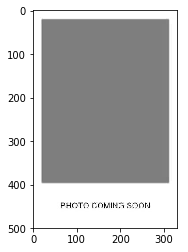

This picture has some problem: ./train/cat.9983.jpg


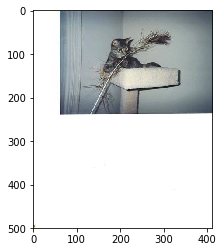

This picture has some problem: ./train/cat.10863.jpg


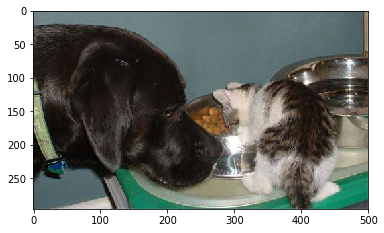

This picture has some problem: ./train/cat.5355.jpg


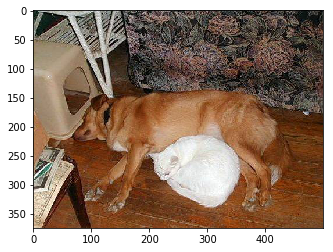

This picture has some problem: ./train/cat.1139.jpg


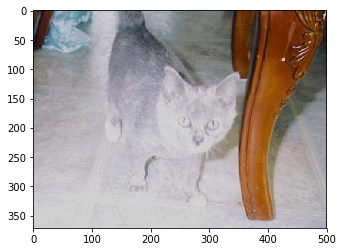

This picture has some problem: ./train/cat.4338.jpg


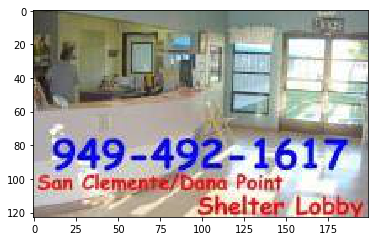

This picture has some problem: ./train/cat.252.jpg


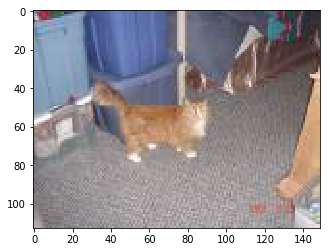

This picture has some problem: ./train/cat.12227.jpg


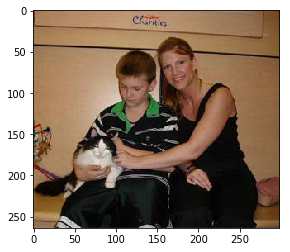

This picture has some problem: ./train/cat.7296.jpg


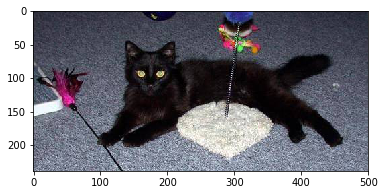

This picture has some problem: ./train/dog.4367.jpg


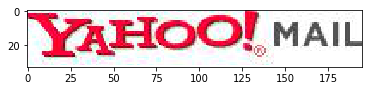

This picture has some problem: ./train/cat.11661.jpg


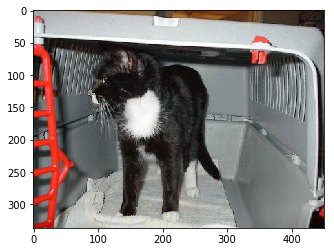

This picture has some problem: ./train/cat.9090.jpg


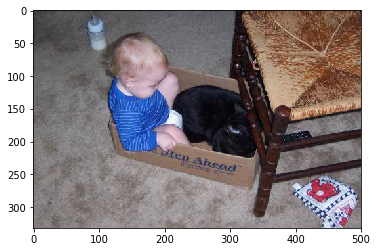

This picture has some problem: ./train/cat.3868.jpg


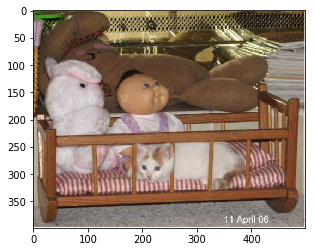

This picture has some problem: ./train/cat.12359.jpg


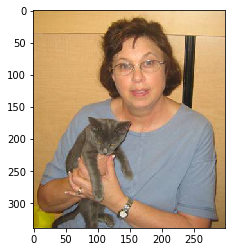

This picture has some problem: ./train/cat.5820.jpg


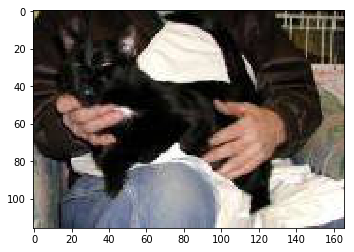

This picture has some problem: ./train/cat.9836.jpg


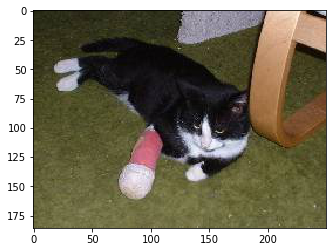

This picture has some problem: ./train/cat.7564.jpg


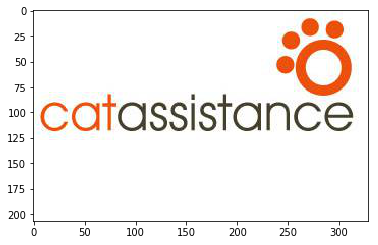

This picture has some problem: ./train/cat.1277.jpg


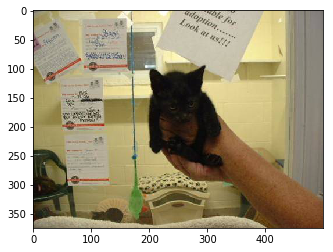

This picture has some problem: ./train/cat.2047.jpg


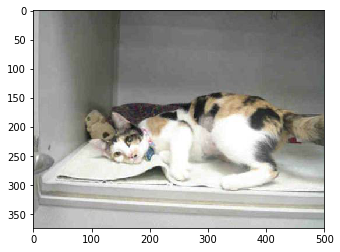

This picture has some problem: ./train/cat.6348.jpg


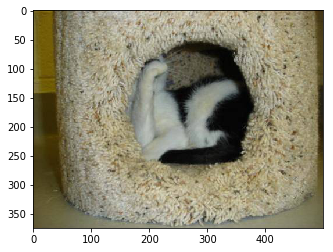

This picture has some problem: ./train/cat.10864.jpg


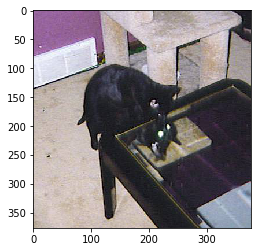

This picture has some problem: ./train/cat.7429.jpg


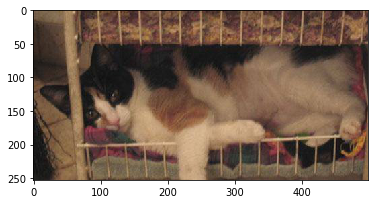

This picture has some problem: ./train/cat.599.jpg


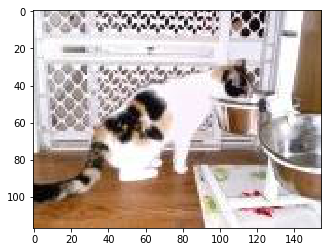

This picture has some problem: ./train/cat.2748.jpg


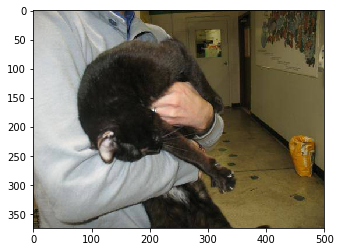

This picture has some problem: ./train/cat.10521.jpg


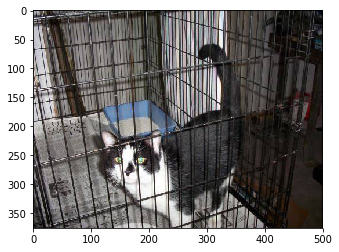

This picture has some problem: ./train/cat.11231.jpg


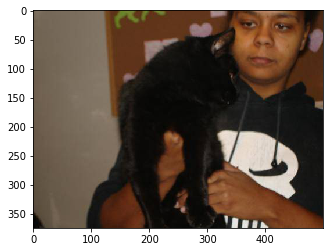

This picture has some problem: ./train/cat.3399.jpg


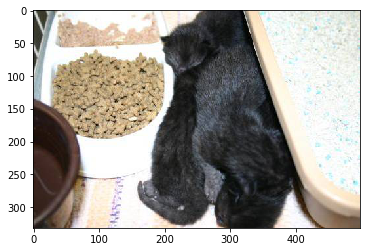

This picture has some problem: ./train/cat.10932.jpg


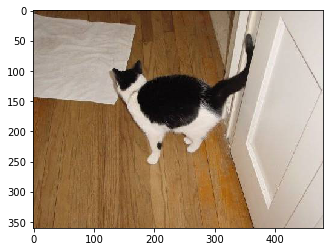

This picture has some problem: ./train/cat.11968.jpg


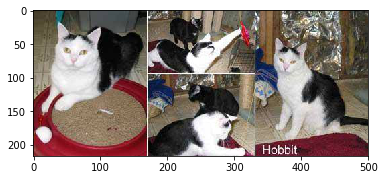

This picture has some problem: ./train/cat.9290.jpg


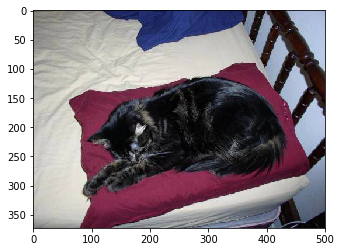

This picture has some problem: ./train/dog.4507.jpg


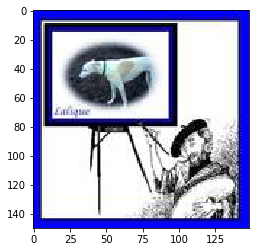

This picture has some problem: ./train/dog.2339.jpg


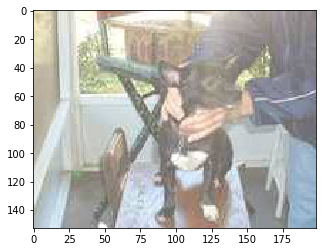

This picture has some problem: ./train/cat.2520.jpg


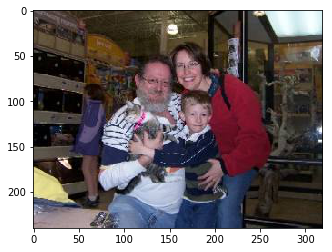

This picture has some problem: ./train/cat.11562.jpg


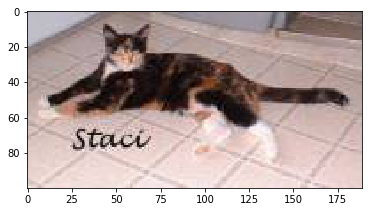

This picture has some problem: ./train/dog.10801.jpg


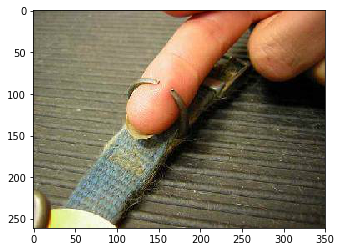

This picture has some problem: ./train/cat.11879.jpg


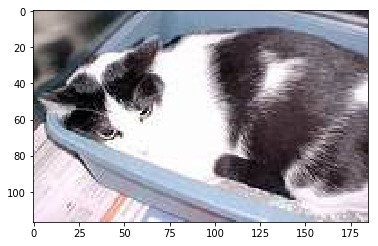

This picture has some problem: ./train/cat.6699.jpg


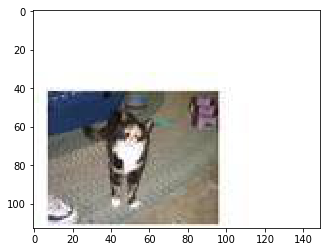

This picture has some problem: ./train/cat.3637.jpg


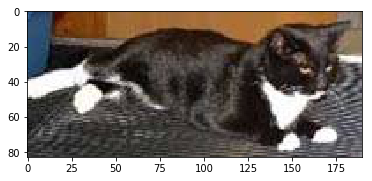

This picture has some problem: ./train/cat.4688.jpg


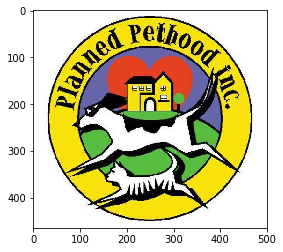

This picture has some problem: ./train/cat.9360.jpg


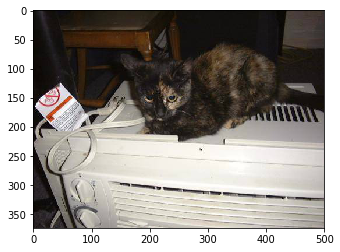

This picture has some problem: ./train/dog.8736.jpg


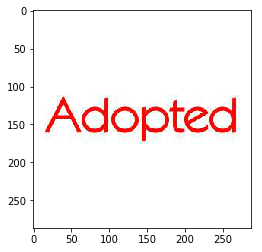

This picture has some problem: ./train/dog.1773.jpg


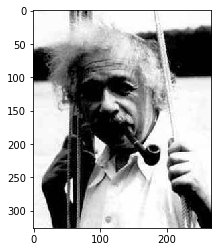

This picture has some problem: ./train/cat.9110.jpg


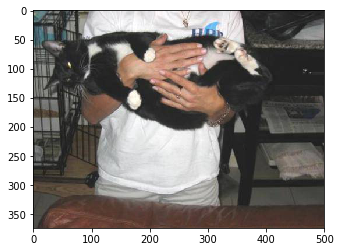

This picture has some problem: ./train/cat.6402.jpg


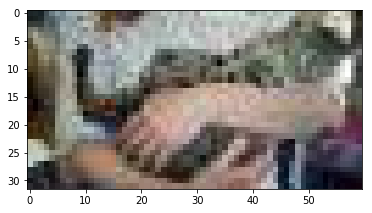

This picture has some problem: ./train/cat.7968.jpg


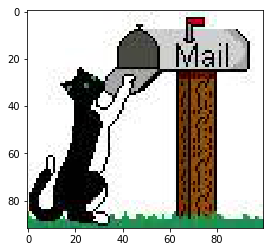

This picture has some problem: ./train/cat.11039.jpg


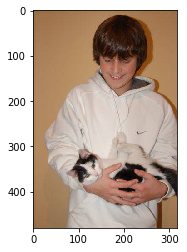

This picture has some problem: ./train/cat.45.jpg


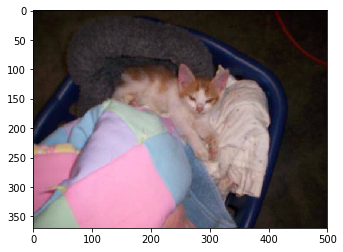

This picture has some problem: ./train/dog.11299.jpg


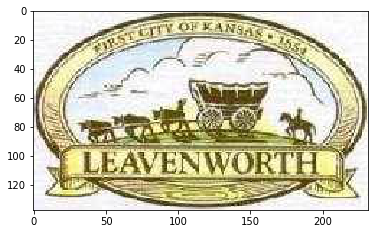

This picture has some problem: ./train/cat.8044.jpg


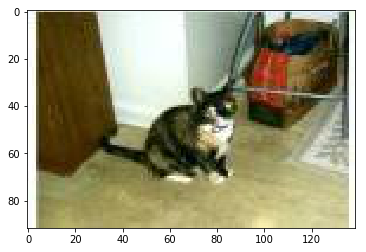

This picture has some problem: ./train/cat.2150.jpg


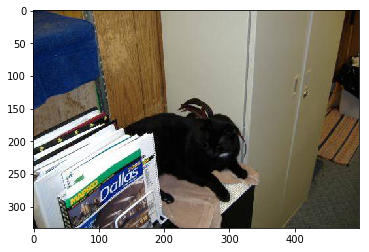

This picture has some problem: ./train/cat.8542.jpg


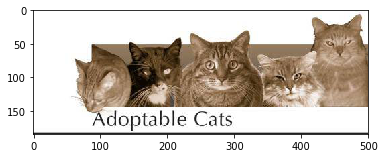

This picture has some problem: ./train/cat.10636.jpg


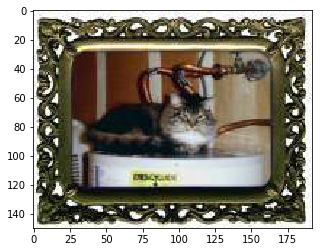

This picture has some problem: ./train/cat.5974.jpg


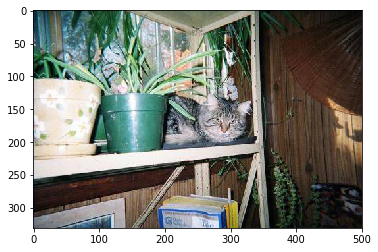

This picture has some problem: ./train/cat.5583.jpg


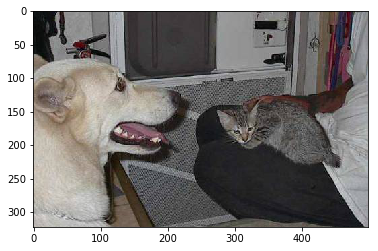

This picture has some problem: ./train/cat.3123.jpg


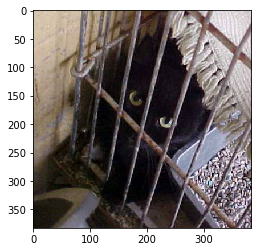

This picture has some problem: ./train/cat.8138.jpg


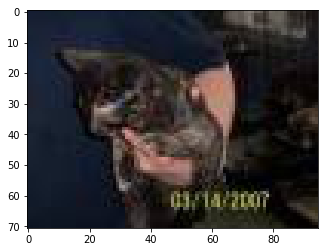

This picture has some problem: ./train/cat.2457.jpg


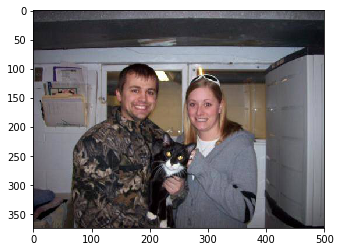

This picture has some problem: ./train/cat.2924.jpg


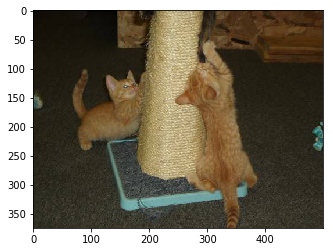

This picture has some problem: ./train/dog.2614.jpg


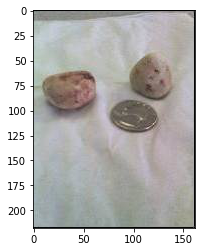

This picture has some problem: ./train/cat.10700.jpg


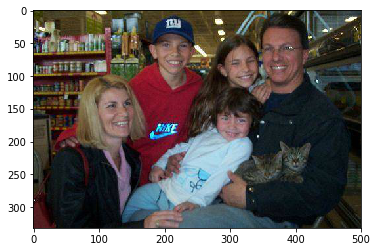

This picture has some problem: ./train/cat.2663.jpg


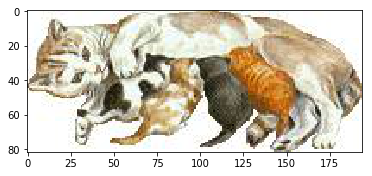

This picture has some problem: ./train/cat.12493.jpg


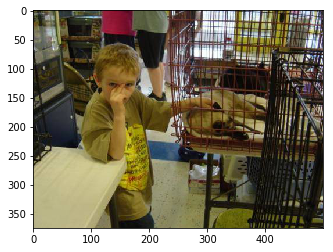

This picture has some problem: ./train/cat.9552.jpg


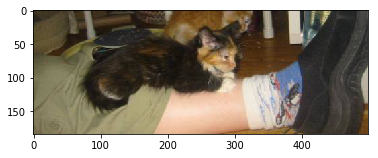

This picture has some problem: ./train/cat.4308.jpg


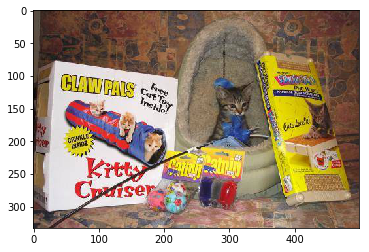

This picture has some problem: ./train/cat.9987.jpg


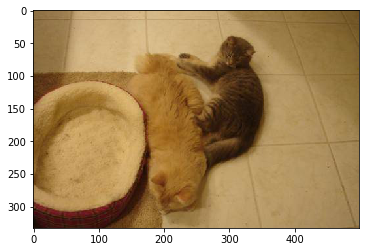

This picture has some problem: ./train/cat.10037.jpg


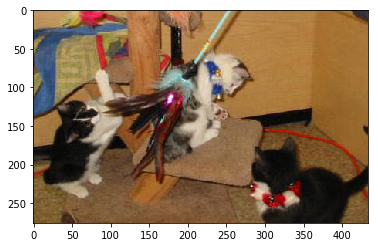

This picture has some problem: ./train/cat.4852.jpg


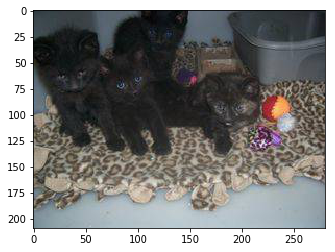

This picture has some problem: ./train/cat.10365.jpg


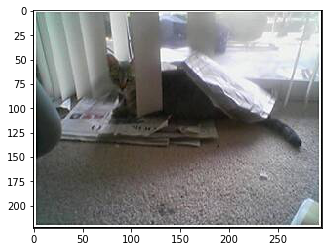

This picture has some problem: ./train/cat.1423.jpg


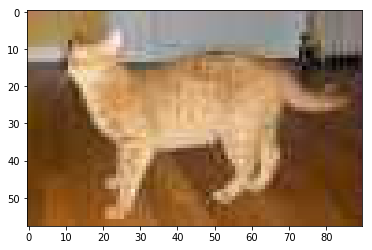

This picture has some problem: ./train/cat.6464.jpg


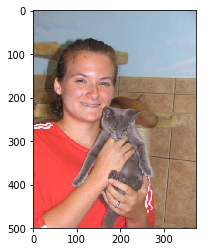

This picture has some problem: ./train/cat.4833.jpg


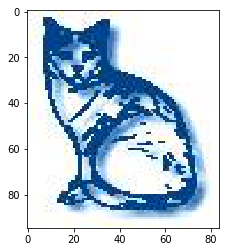

This picture has some problem: ./train/cat.7291.jpg


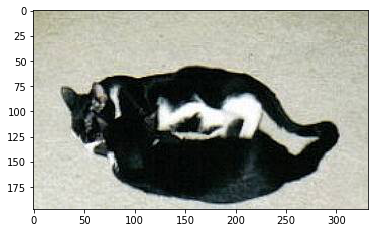

This picture has some problem: ./train/dog.7706.jpg


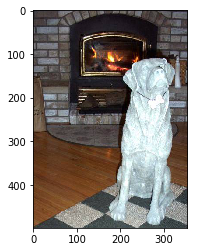

This picture has some problem: ./train/cat.8828.jpg


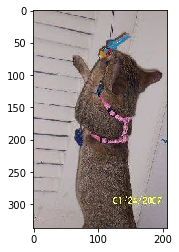

This picture has some problem: ./train/cat.10912.jpg


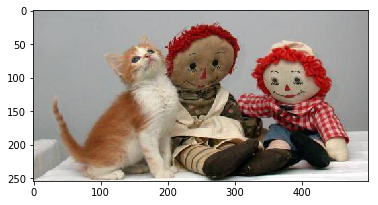

This picture has some problem: ./train/dog.9517.jpg


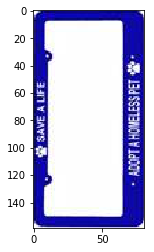

This picture has some problem: ./train/cat.3216.jpg


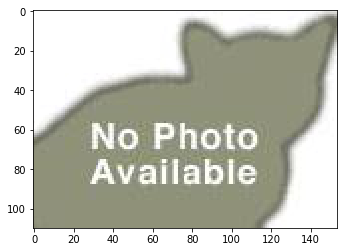

This picture has some problem: ./train/cat.1361.jpg


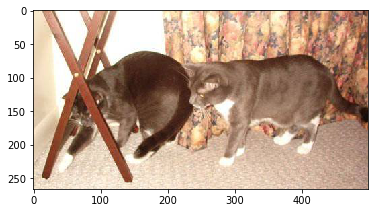

This picture has some problem: ./train/cat.10029.jpg


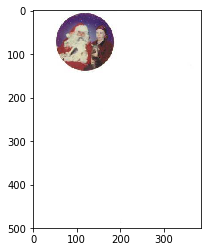

This picture has some problem: ./train/cat.12476.jpg


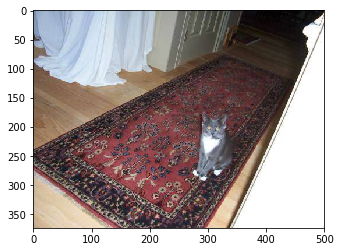

This picture has some problem: ./train/cat.2939.jpg


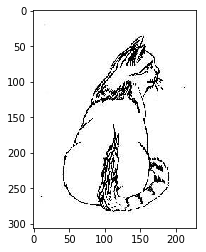

This picture has some problem: ./train/cat.2337.jpg


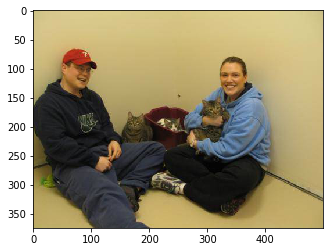

This picture has some problem: ./train/cat.9513.jpg


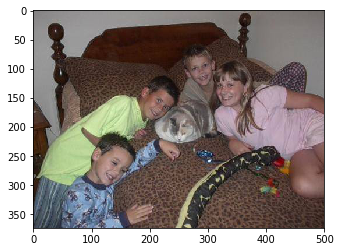

This picture has some problem: ./train/cat.1619.jpg


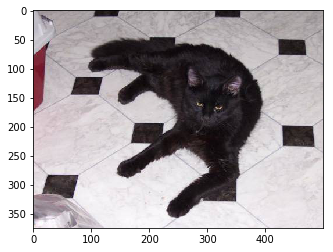

This picture has some problem: ./train/cat.12272.jpg


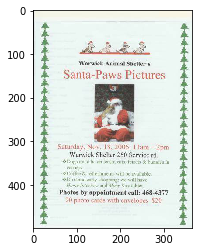

This picture has some problem: ./train/cat.4190.jpg


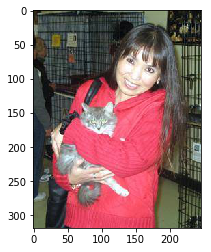

This picture has some problem: ./train/cat.297.jpg


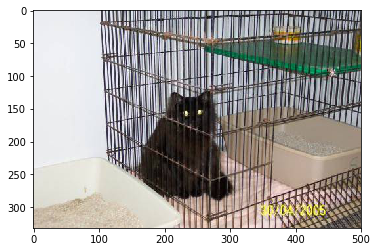

This picture has some problem: ./train/cat.7206.jpg


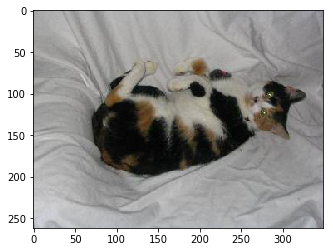

This picture has some problem: ./train/cat.6017.jpg


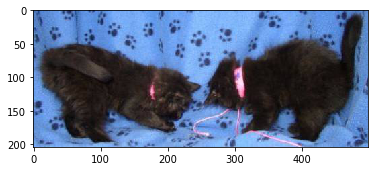

This picture has some problem: ./train/cat.10430.jpg


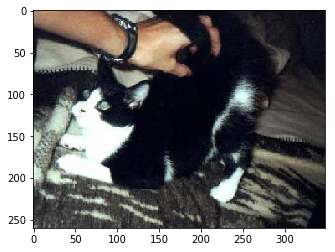

This picture has some problem: ./train/cat.1631.jpg


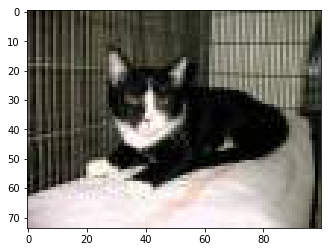

This picture has some problem: ./train/cat.8122.jpg


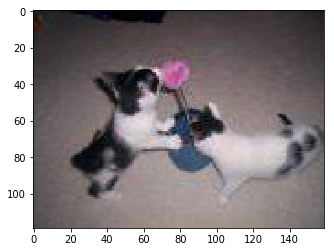

This picture has some problem: ./train/cat.12392.jpg


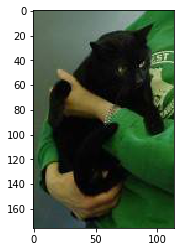

This picture has some problem: ./train/cat.12326.jpg


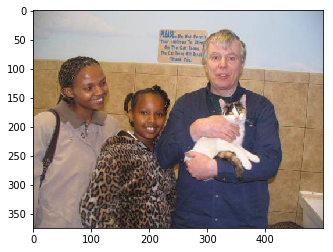

This picture has some problem: ./train/cat.10712.jpg


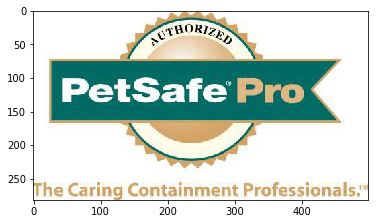

This picture has some problem: ./train/cat.8921.jpg


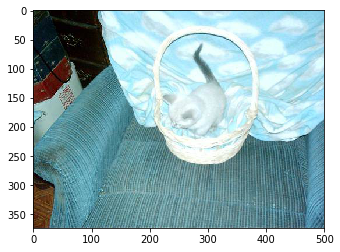

This picture has some problem: ./train/cat.11823.jpg


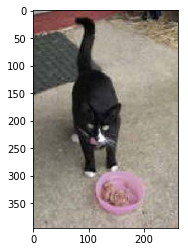

This picture has some problem: ./train/cat.10536.jpg


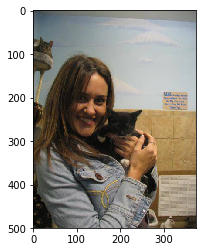

This picture has some problem: ./train/cat.6442.jpg


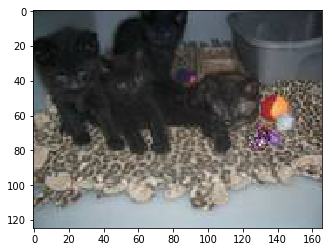

This picture has some problem: ./train/cat.587.jpg


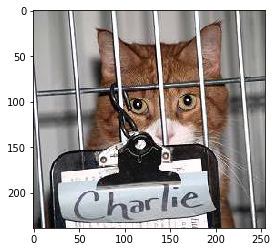

This picture has some problem: ./train/cat.11297.jpg


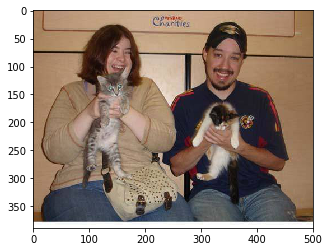

This picture has some problem: ./train/cat.6915.jpg


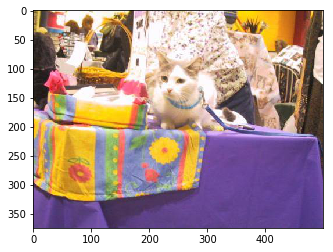

This picture has some problem: ./train/cat.335.jpg


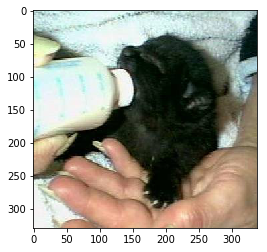

This picture has some problem: ./train/dog.12155.jpg


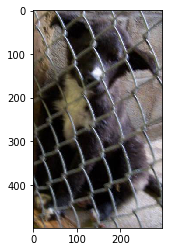

This picture has some problem: ./train/dog.6725.jpg


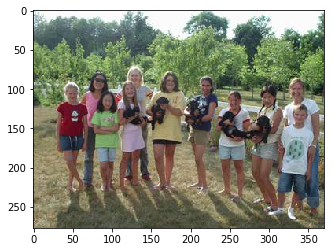

This picture has some problem: ./train/cat.2893.jpg


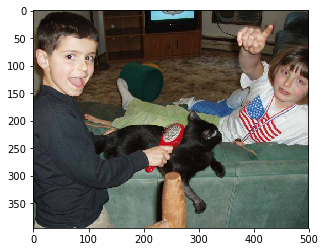

This picture has some problem: ./train/cat.8087.jpg


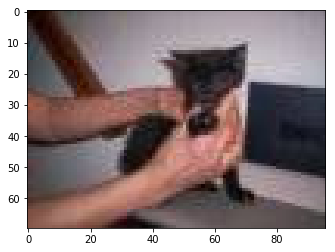

This picture has some problem: ./train/dog.12376.jpg


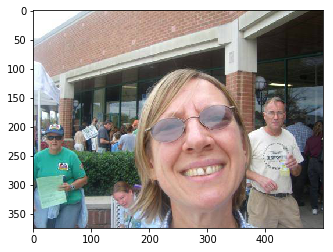

This picture has some problem: ./train/dog.6475.jpg


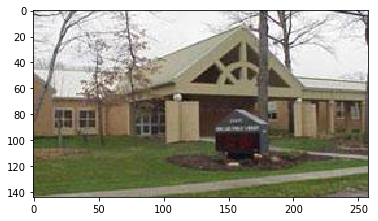

This picture has some problem: ./train/cat.7009.jpg


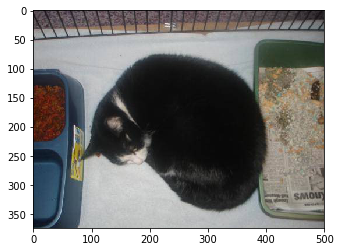

This picture has some problem: ./train/cat.9695.jpg


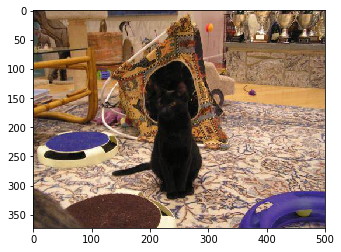

This picture has some problem: ./train/cat.6345.jpg


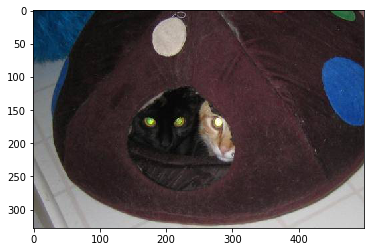

This picture has some problem: ./train/cat.5472.jpg


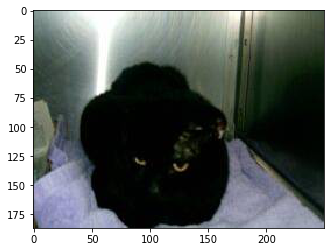

This picture has some problem: ./train/cat.5351.jpg


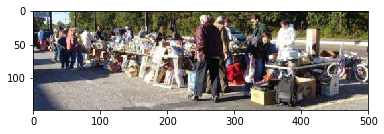

This picture has some problem: ./train/cat.6429.jpg


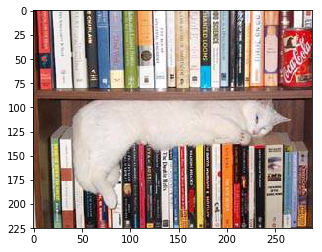

This picture has some problem: ./train/dog.1625.jpg


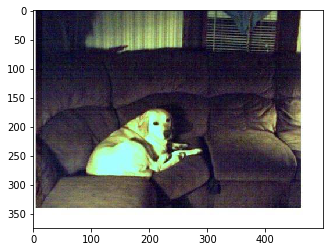

This picture has some problem: ./train/cat.7899.jpg


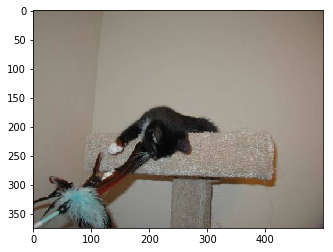

This picture has some problem: ./train/cat.12222.jpg


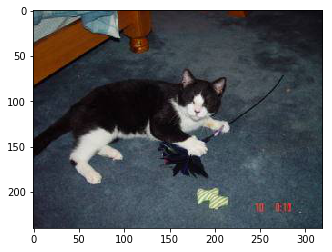

This picture has some problem: ./train/dog.7076.jpg


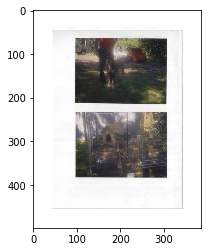

This picture has some problem: ./train/cat.8383.jpg


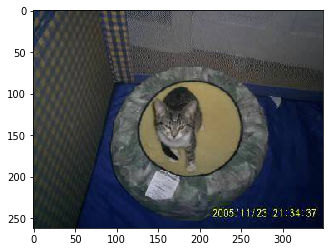

This picture has some problem: ./train/cat.11724.jpg


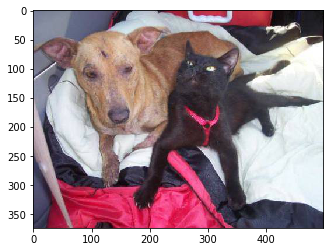

This picture has some problem: ./train/cat.372.jpg


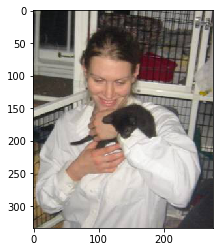

This picture has some problem: ./train/cat.4272.jpg


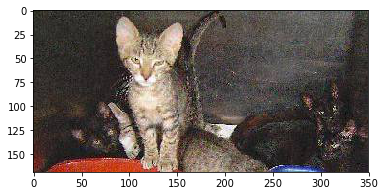

This picture has some problem: ./train/dog.4218.jpg


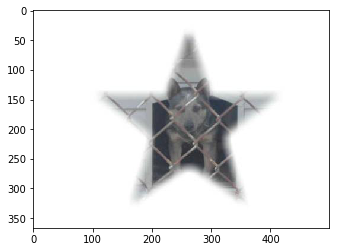

This picture has some problem: ./train/cat.7432.jpg


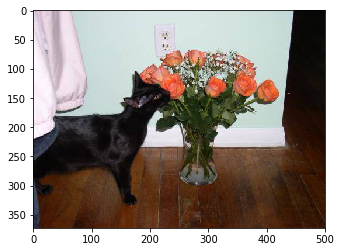

This picture has some problem: ./train/dog.10237.jpg


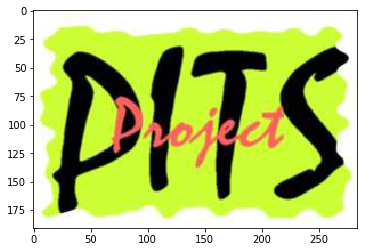

This picture has some problem: ./train/cat.7728.jpg


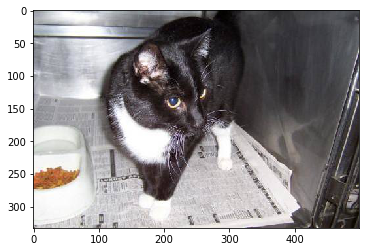

This picture has some problem: ./train/dog.5604.jpg


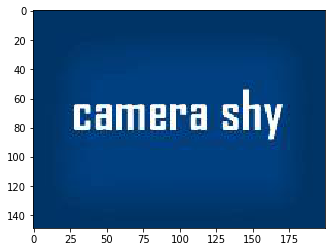

This picture has some problem: ./train/cat.7920.jpg


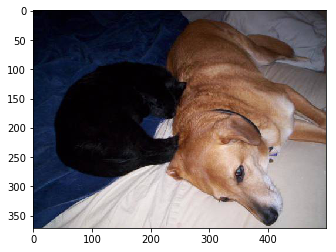

This picture has some problem: ./train/cat.10270.jpg


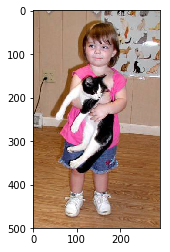

This picture has some problem: ./train/cat.8456.jpg


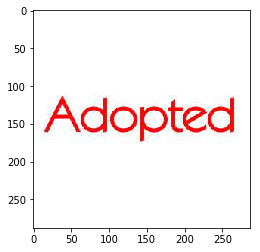

This picture has some problem: ./train/cat.3731.jpg


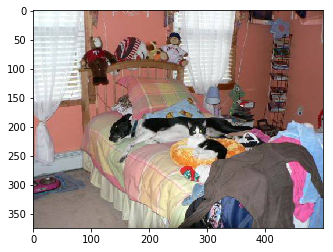

This picture has some problem: ./train/cat.8470.jpg


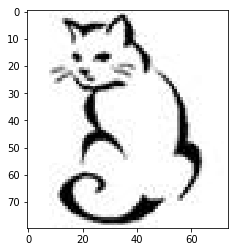

This picture has some problem: ./train/cat.3672.jpg


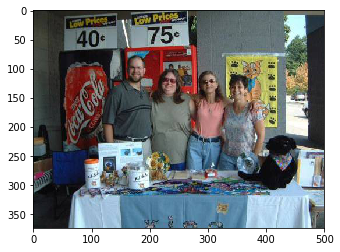

This picture has some problem: ./train/cat.5712.jpg


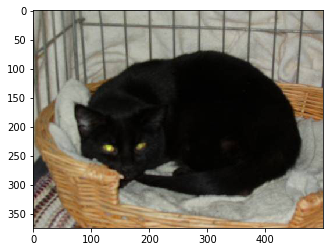

This picture has some problem: ./train/cat.169.jpg


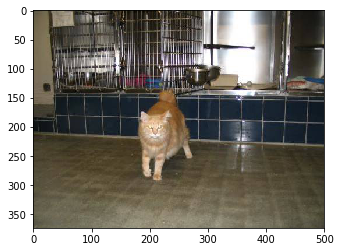

This picture has some problem: ./train/cat.4575.jpg


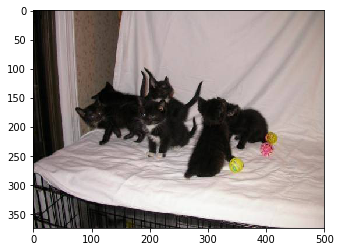

This picture has some problem: ./train/cat.9622.jpg


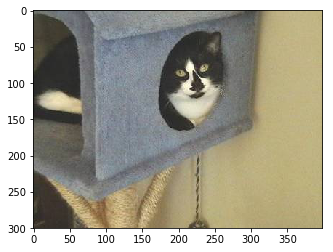

This picture has some problem: ./train/cat.7377.jpg


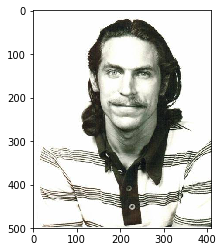

This picture has some problem: ./train/cat.4360.jpg


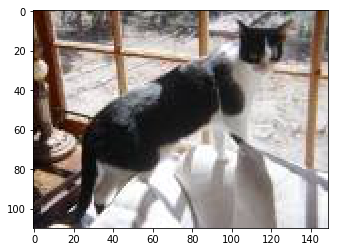

This picture has some problem: ./train/cat.12424.jpg


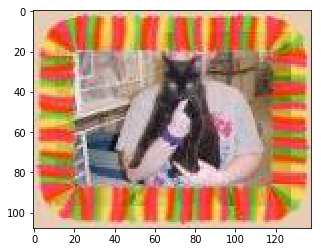

This picture has some problem: ./train/cat.796.jpg


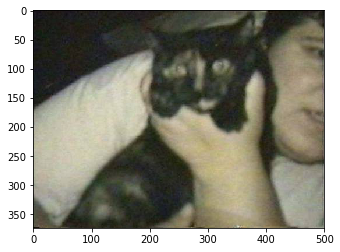

This picture has some problem: ./train/cat.4842.jpg


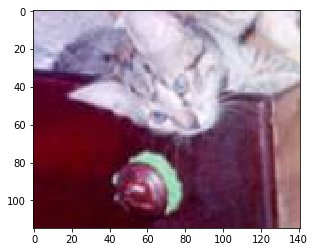

This picture has some problem: ./train/cat.2737.jpg


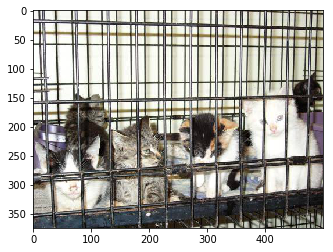

This picture has some problem: ./train/cat.2817.jpg


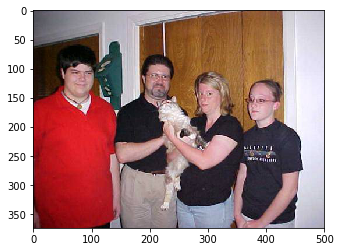

This picture has some problem: ./train/cat.5418.jpg


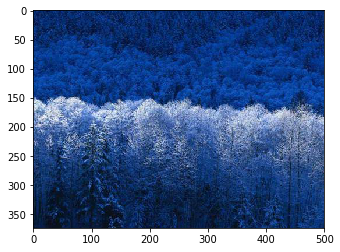

This picture has some problem: ./train/cat.9171.jpg


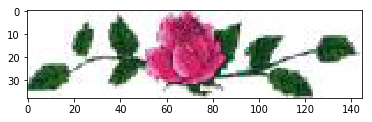

This picture has some problem: ./train/cat.7758.jpg


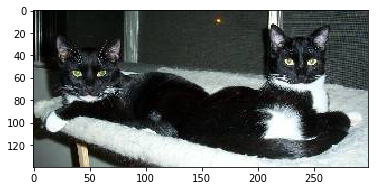

This picture has some problem: ./train/cat.12378.jpg


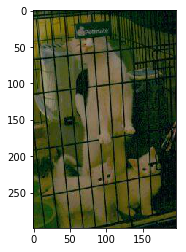

This picture has some problem: ./train/dog.10161.jpg


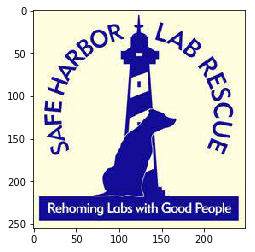

This picture has some problem: ./train/dog.1194.jpg


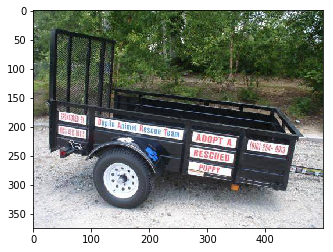

This picture has some problem: ./train/cat.9596.jpg


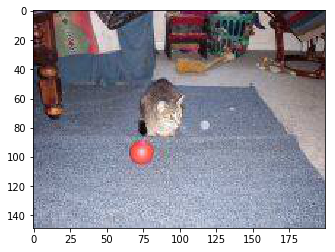

This picture has some problem: ./train/cat.11565.jpg


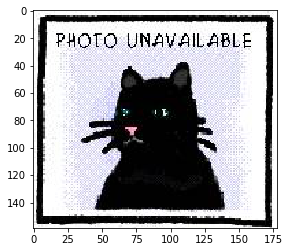

This picture has some problem: ./train/dog.11437.jpg


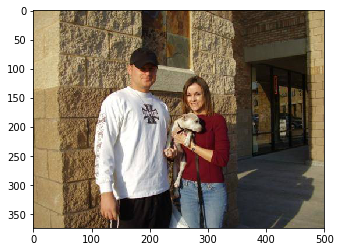

This picture has some problem: ./train/cat.8431.jpg


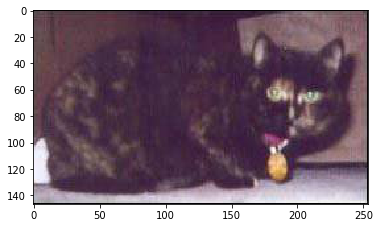

This picture has some problem: ./train/cat.9494.jpg


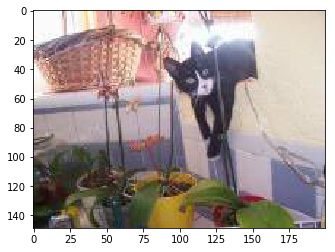

This picture has some problem: ./train/dog.2422.jpg


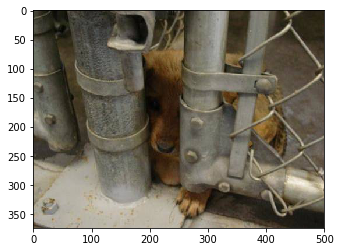

This picture has some problem: ./train/cat.4986.jpg


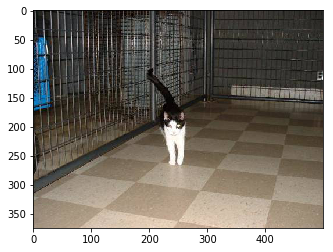

This picture has some problem: ./train/cat.11457.jpg


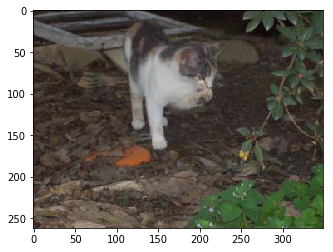

This picture has some problem: ./train/cat.6530.jpg


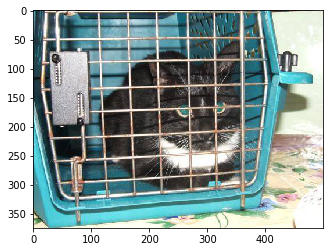

This picture has some problem: ./train/cat.11399.jpg


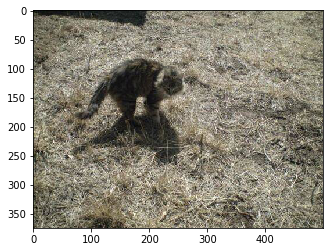

This picture has some problem: ./train/cat.7130.jpg


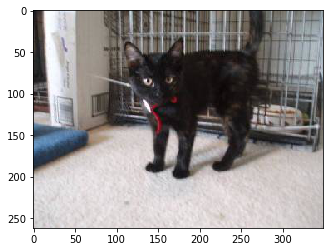

This picture has some problem: ./train/cat.11607.jpg


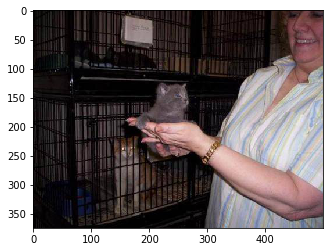

This picture has some problem: ./train/cat.11222.jpg


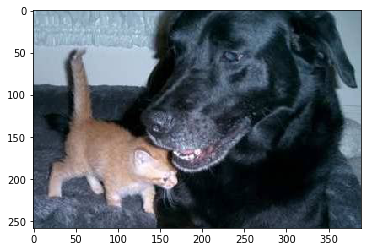

['./train/cat.11184.jpg', './train/cat.9983.jpg', './train/cat.10863.jpg', './train/cat.5355.jpg', './train/cat.1139.jpg', './train/cat.4338.jpg', './train/cat.252.jpg', './train/cat.12227.jpg', './train/cat.7296.jpg', './train/dog.4367.jpg', './train/cat.11661.jpg', './train/cat.9090.jpg', './train/cat.3868.jpg', './train/cat.12359.jpg', './train/cat.5820.jpg', './train/cat.9836.jpg', './train/cat.7564.jpg', './train/cat.1277.jpg', './train/cat.2047.jpg', './train/cat.6348.jpg', './train/cat.10864.jpg', './train/cat.7429.jpg', './train/cat.599.jpg', './train/cat.2748.jpg', './train/cat.10521.jpg', './train/cat.11231.jpg', './train/cat.3399.jpg', './train/cat.10932.jpg', './train/cat.11968.jpg', './train/cat.9290.jpg', './train/dog.4507.jpg', './train/dog.2339.jpg', './train/cat.2520.jpg', './train/cat.11562.jpg', './train/dog.10801.jpg', './train/cat.11879.jpg', './train/cat.6699.jpg', './train/cat.3637.jpg', './train/cat.4688.jpg', './train/cat.9360.jpg', './train/dog.8736.jpg', './t

In [68]:
#使用ResNet50检测异常数据
model = ResNet50(weights='imagenet')
bad_pictures=clean_up_dataset(model,threshold=50,size=len(data_files))
print(bad_pictures)
print(len(bad_pictures))

This picture has some problem: ./train/cat.11184.jpg


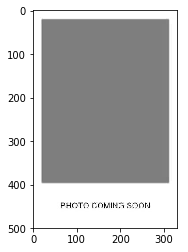

This picture has some problem: ./train/cat.9983.jpg


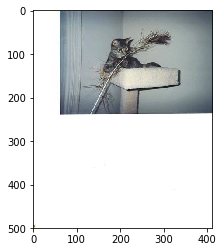

This picture has some problem: ./train/cat.7668.jpg


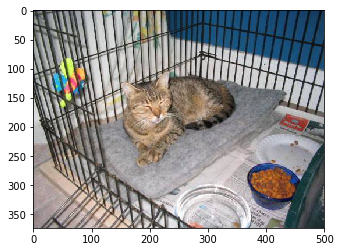

This picture has some problem: ./train/cat.5355.jpg


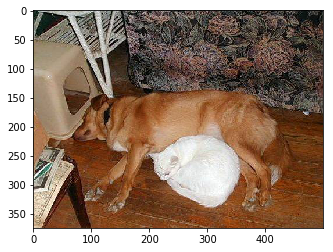

This picture has some problem: ./train/cat.4338.jpg


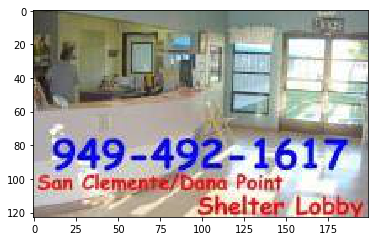

This picture has some problem: ./train/cat.2433.jpg


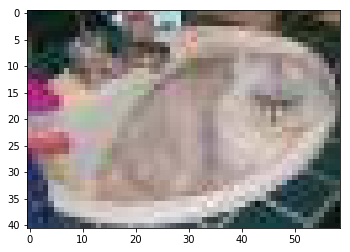

This picture has some problem: ./train/cat.252.jpg


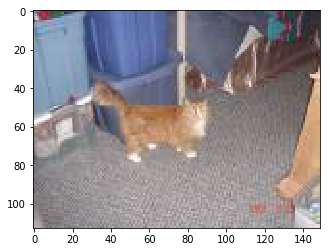

This picture has some problem: ./train/dog.4367.jpg


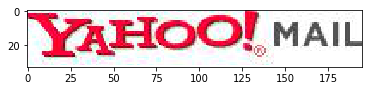

This picture has some problem: ./train/cat.503.jpg


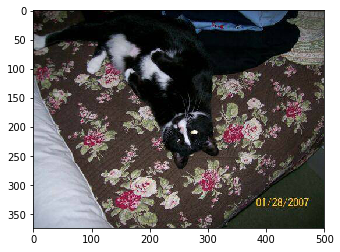

This picture has some problem: ./train/cat.3868.jpg


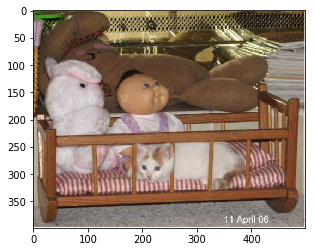

This picture has some problem: ./train/cat.7564.jpg


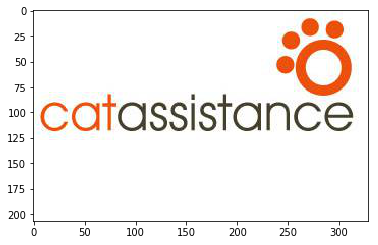

This picture has some problem: ./train/dog.1895.jpg


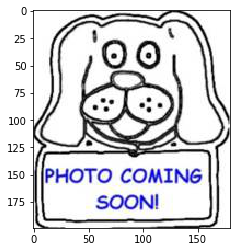

This picture has some problem: ./train/cat.2509.jpg


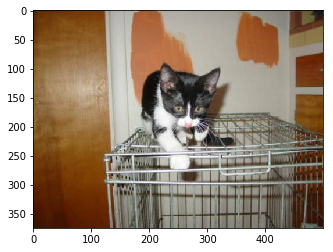

This picture has some problem: ./train/dog.10747.jpg


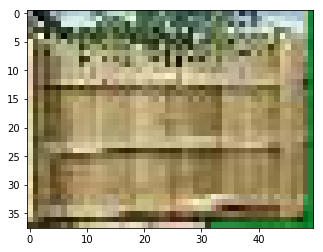

This picture has some problem: ./train/cat.7599.jpg


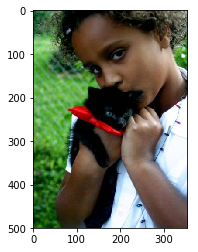

This picture has some problem: ./train/cat.9290.jpg


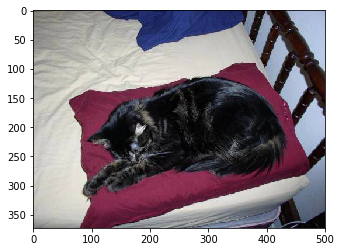

This picture has some problem: ./train/dog.9188.jpg


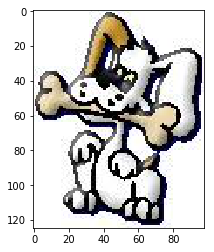

This picture has some problem: ./train/cat.2520.jpg


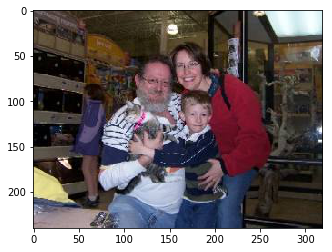

This picture has some problem: ./train/dog.10801.jpg


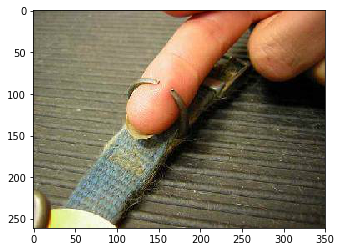

This picture has some problem: ./train/cat.6699.jpg


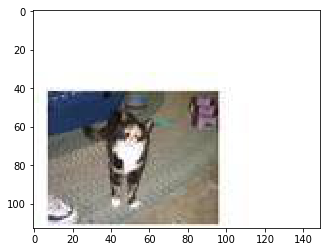

This picture has some problem: ./train/dog.11266.jpg


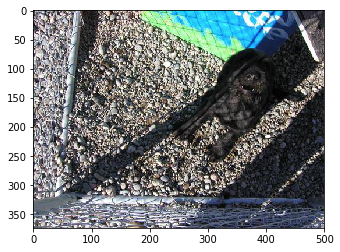

This picture has some problem: ./train/cat.4688.jpg


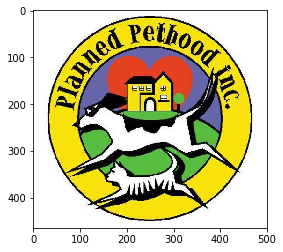

This picture has some problem: ./train/dog.8736.jpg


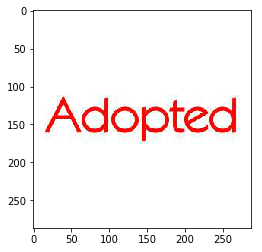

This picture has some problem: ./train/dog.1773.jpg


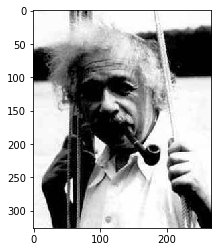

This picture has some problem: ./train/cat.9110.jpg


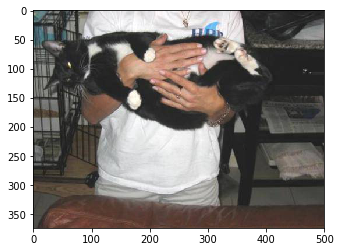

This picture has some problem: ./train/cat.7968.jpg


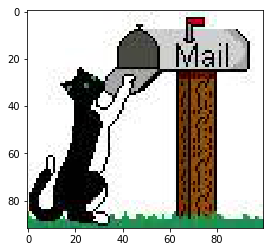

This picture has some problem: ./train/cat.5347.jpg


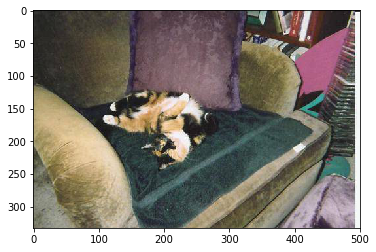

This picture has some problem: ./train/cat.9589.jpg


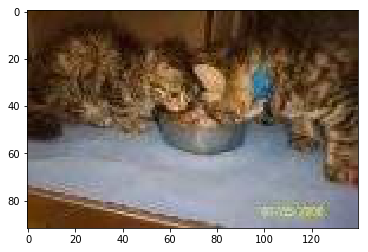

This picture has some problem: ./train/cat.5974.jpg


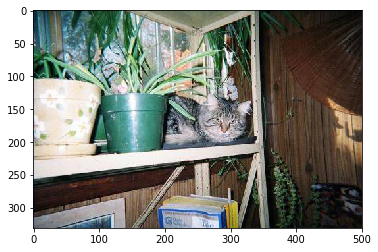

This picture has some problem: ./train/dog.8898.jpg


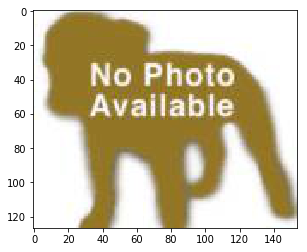

This picture has some problem: ./train/dog.10190.jpg


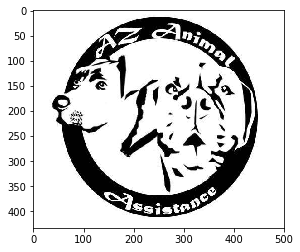

This picture has some problem: ./train/cat.2457.jpg


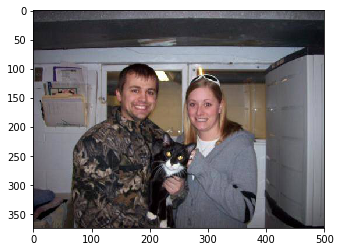

This picture has some problem: ./train/cat.11701.jpg


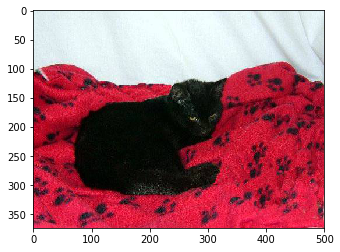

This picture has some problem: ./train/dog.2614.jpg


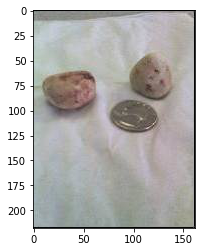

This picture has some problem: ./train/cat.10700.jpg


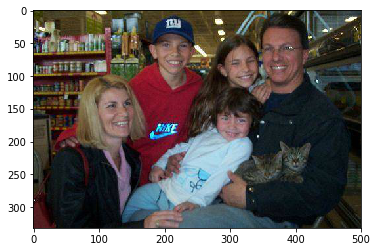

This picture has some problem: ./train/cat.2663.jpg


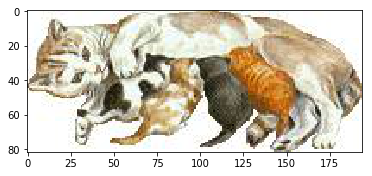

This picture has some problem: ./train/cat.12493.jpg


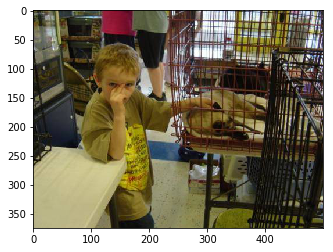

This picture has some problem: ./train/cat.4503.jpg


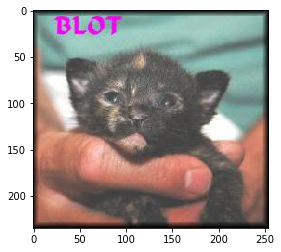

This picture has some problem: ./train/cat.4308.jpg


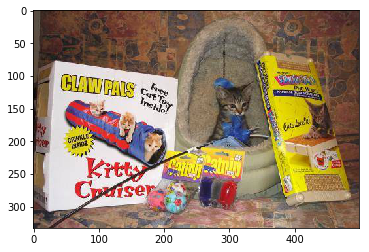

This picture has some problem: ./train/cat.10037.jpg


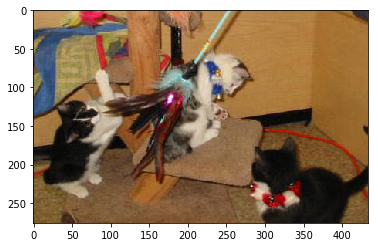

This picture has some problem: ./train/cat.4852.jpg


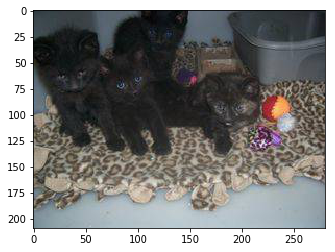

This picture has some problem: ./train/cat.10365.jpg


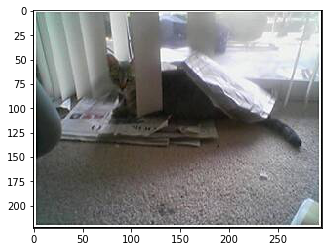

This picture has some problem: ./train/dog.9517.jpg


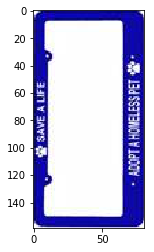

This picture has some problem: ./train/cat.3216.jpg


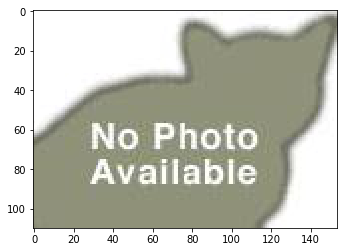

This picture has some problem: ./train/cat.1361.jpg


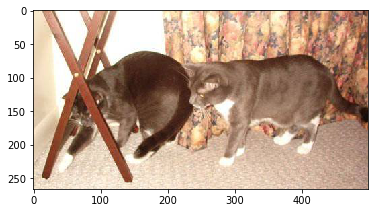

This picture has some problem: ./train/cat.3004.jpg


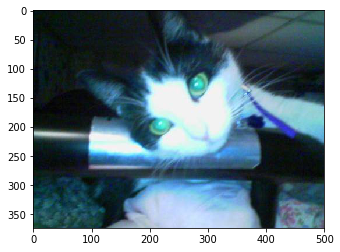

This picture has some problem: ./train/cat.10029.jpg


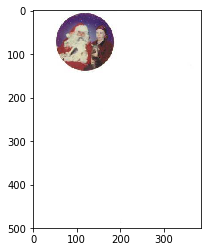

This picture has some problem: ./train/cat.2939.jpg


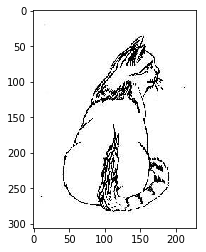

This picture has some problem: ./train/cat.2337.jpg


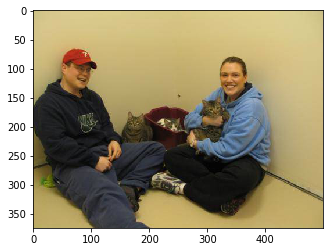

This picture has some problem: ./train/cat.4773.jpg


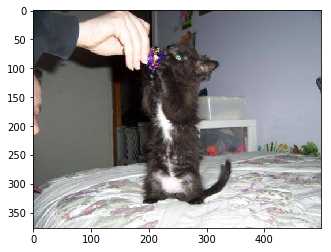

This picture has some problem: ./train/cat.12272.jpg


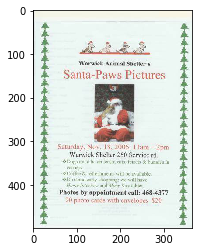

This picture has some problem: ./train/cat.8122.jpg


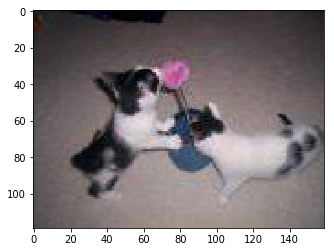

This picture has some problem: ./train/cat.10712.jpg


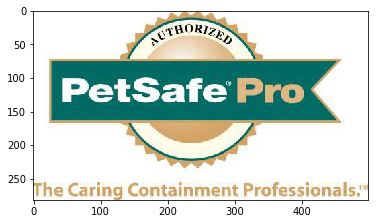

This picture has some problem: ./train/cat.8921.jpg


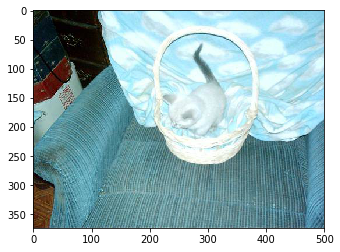

This picture has some problem: ./train/cat.3822.jpg


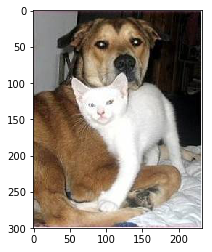

This picture has some problem: ./train/cat.6418.jpg


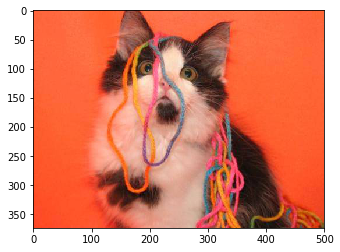

This picture has some problem: ./train/cat.10536.jpg


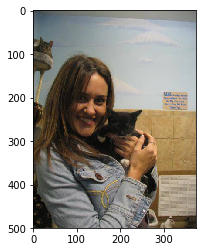

This picture has some problem: ./train/cat.6442.jpg


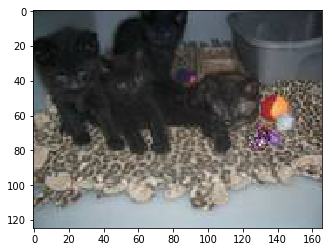

This picture has some problem: ./train/cat.335.jpg


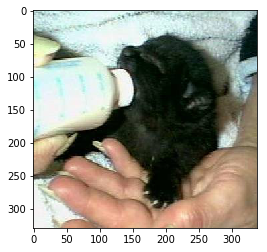

This picture has some problem: ./train/dog.12155.jpg


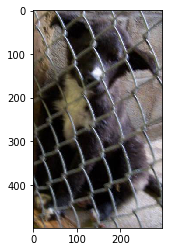

This picture has some problem: ./train/dog.6725.jpg


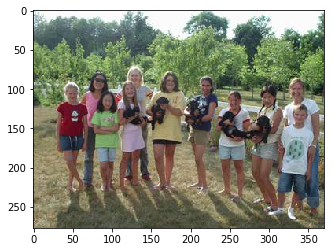

This picture has some problem: ./train/cat.11062.jpg


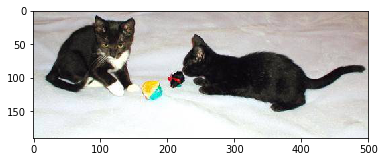

This picture has some problem: ./train/cat.3881.jpg


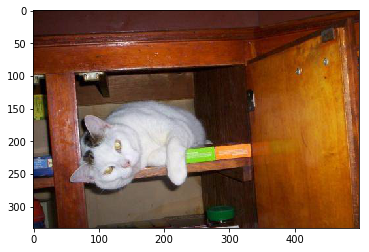

This picture has some problem: ./train/cat.2893.jpg


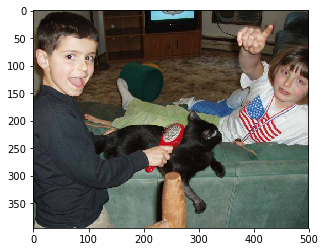

This picture has some problem: ./train/dog.12376.jpg


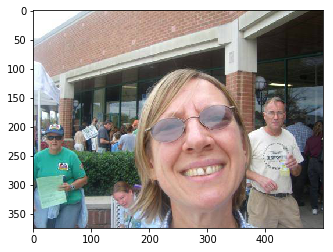

This picture has some problem: ./train/dog.6475.jpg


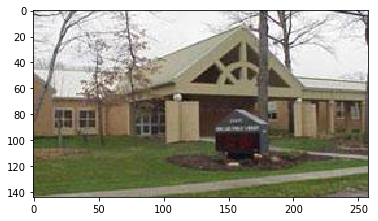

This picture has some problem: ./train/cat.4126.jpg


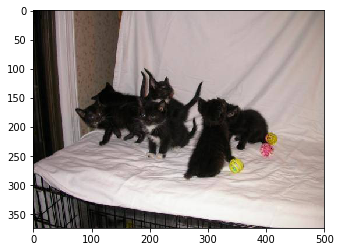

This picture has some problem: ./train/cat.8068.jpg


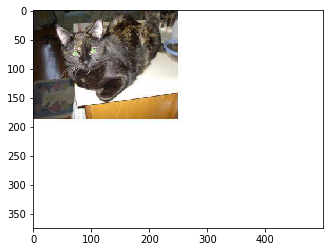

This picture has some problem: ./train/cat.9456.jpg


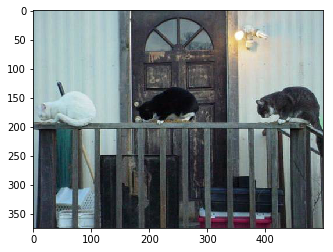

This picture has some problem: ./train/cat.6345.jpg


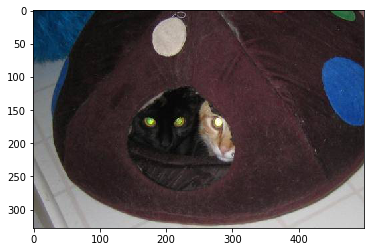

This picture has some problem: ./train/cat.5351.jpg


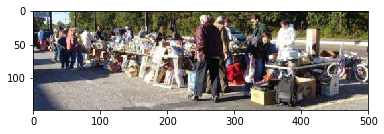

This picture has some problem: ./train/cat.6429.jpg


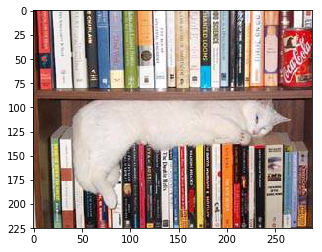

This picture has some problem: ./train/cat.7899.jpg


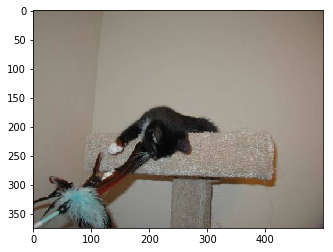

This picture has some problem: ./train/cat.3946.jpg


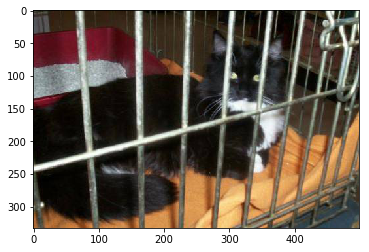

This picture has some problem: ./train/cat.11365.jpg


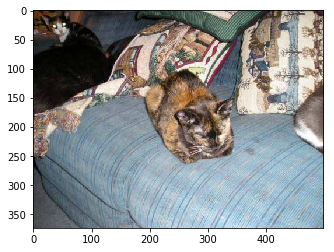

This picture has some problem: ./train/cat.11724.jpg


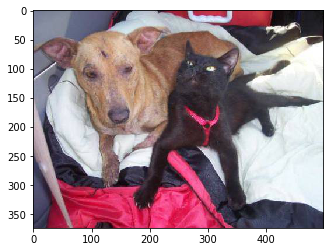

This picture has some problem: ./train/dog.3889.jpg


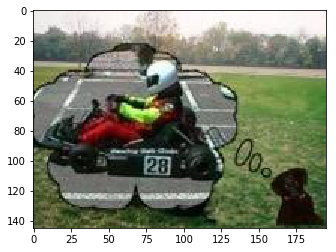

This picture has some problem: ./train/cat.372.jpg


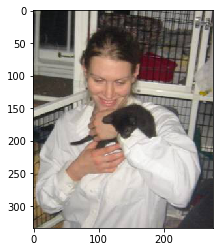

This picture has some problem: ./train/cat.376.jpg


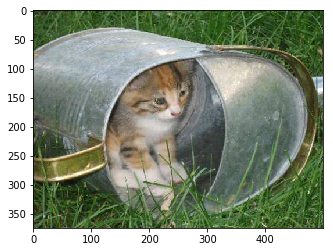

This picture has some problem: ./train/dog.10237.jpg


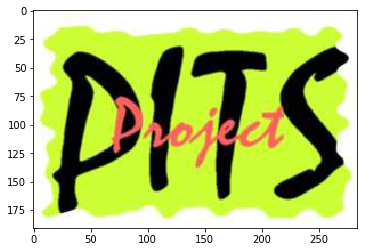

This picture has some problem: ./train/dog.5604.jpg


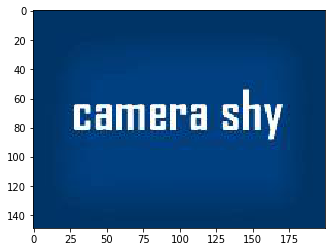

This picture has some problem: ./train/cat.7920.jpg


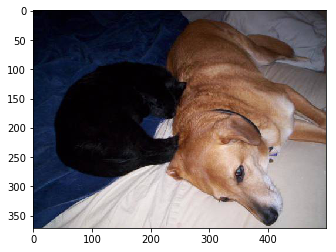

This picture has some problem: ./train/cat.10270.jpg


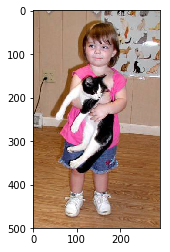

This picture has some problem: ./train/cat.10946.jpg


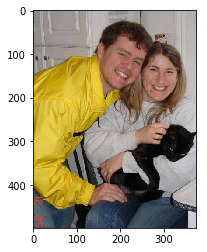

This picture has some problem: ./train/cat.8456.jpg


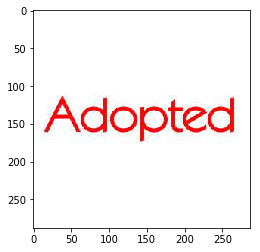

This picture has some problem: ./train/cat.3731.jpg


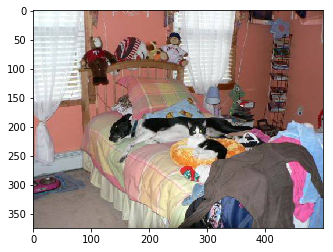

This picture has some problem: ./train/cat.3672.jpg


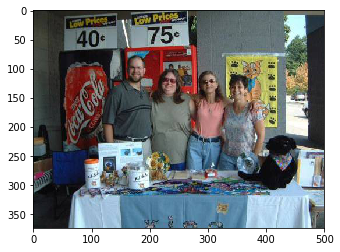

This picture has some problem: ./train/cat.169.jpg


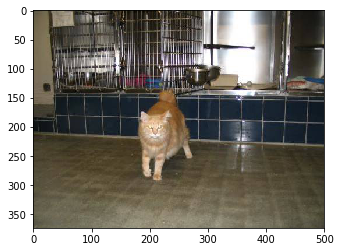

This picture has some problem: ./train/cat.7377.jpg


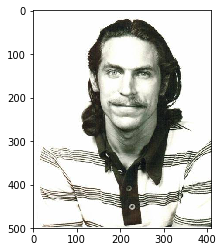

This picture has some problem: ./train/cat.12424.jpg


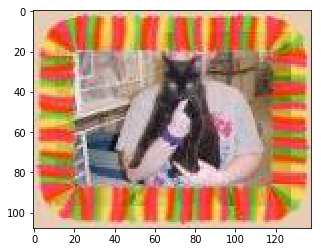

This picture has some problem: ./train/cat.2737.jpg


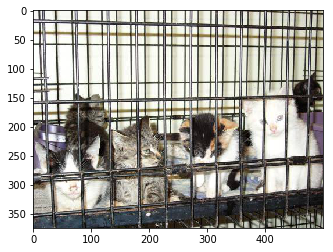

This picture has some problem: ./train/cat.5418.jpg


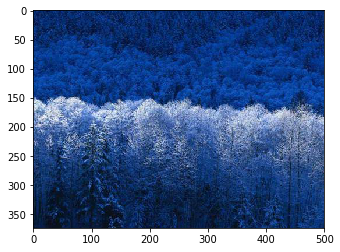

This picture has some problem: ./train/cat.9171.jpg


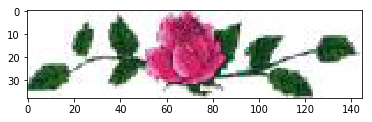

This picture has some problem: ./train/cat.12378.jpg


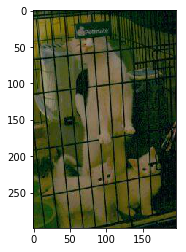

This picture has some problem: ./train/dog.10161.jpg


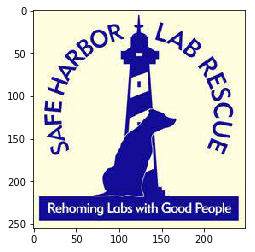

This picture has some problem: ./train/dog.1194.jpg


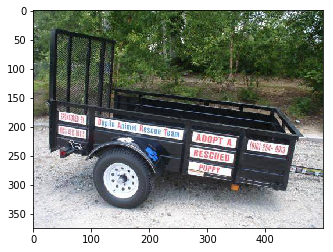

This picture has some problem: ./train/cat.9596.jpg


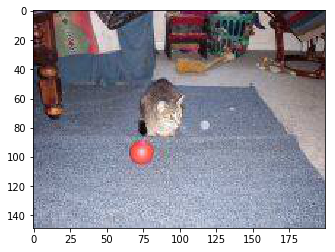

This picture has some problem: ./train/cat.9494.jpg


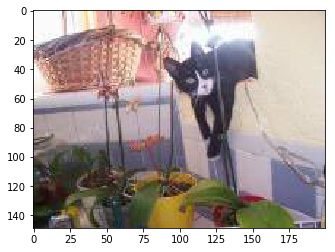

This picture has some problem: ./train/dog.2422.jpg


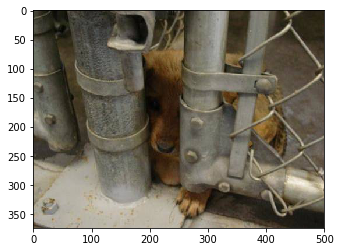

This picture has some problem: ./train/cat.4986.jpg


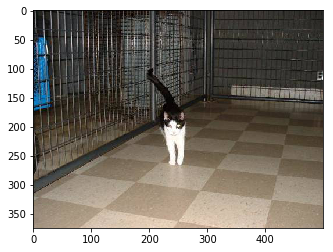

This picture has some problem: ./train/dog.1308.jpg


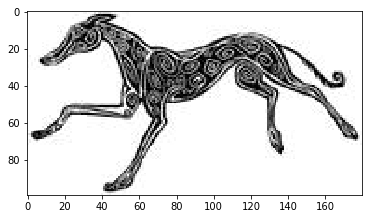

This picture has some problem: ./train/cat.11222.jpg


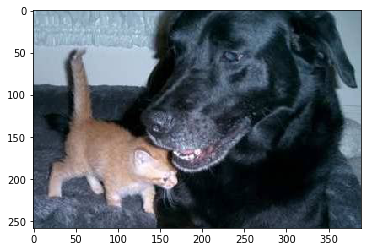

['./train/cat.11184.jpg', './train/cat.9983.jpg', './train/cat.7668.jpg', './train/cat.5355.jpg', './train/cat.4338.jpg', './train/cat.2433.jpg', './train/cat.252.jpg', './train/dog.4367.jpg', './train/cat.503.jpg', './train/cat.3868.jpg', './train/cat.7564.jpg', './train/dog.1895.jpg', './train/cat.2509.jpg', './train/dog.10747.jpg', './train/cat.7599.jpg', './train/cat.9290.jpg', './train/dog.9188.jpg', './train/cat.2520.jpg', './train/dog.10801.jpg', './train/cat.6699.jpg', './train/dog.11266.jpg', './train/cat.4688.jpg', './train/dog.8736.jpg', './train/dog.1773.jpg', './train/cat.9110.jpg', './train/cat.7968.jpg', './train/cat.5347.jpg', './train/cat.9589.jpg', './train/cat.5974.jpg', './train/dog.8898.jpg', './train/dog.10190.jpg', './train/cat.2457.jpg', './train/cat.11701.jpg', './train/dog.2614.jpg', './train/cat.10700.jpg', './train/cat.2663.jpg', './train/cat.12493.jpg', './train/cat.4503.jpg', './train/cat.4308.jpg', './train/cat.10037.jpg', './train/cat.4852.jpg', './train

In [69]:
#使用InceptionResNetV2来检验异常值
model_inception_resnet = InceptionResNetV2(include_top=True,weights='imagenet')
bad_pictures2=clean_up_dataset(model_inception_resnet,threshold=50,size=len(data_files),preprocess_function=preprocess_inception_resnet)
print(bad_pictures2)
print(len(bad_pictures2))

In [30]:
#使用IInceptionV3来检验异常值
from keras.applications.inception_v3  import InceptionV3
model_inception = InceptionV3(include_top=True,weights='imagenet')
bad_pictures3=clean_up_dataset(model_inception,threshold=50,size=len(data_files),preprocess_function=preprocess_inception)
print(bad_pictures3)
print(len(bad_pictures3))

KeyboardInterrupt: 

In [4]:
list_rest50=['./train/cat.11184.jpg', './train/cat.9983.jpg', './train/cat.10863.jpg', './train/cat.5355.jpg', './train/cat.1139.jpg', './train/cat.4338.jpg', './train/cat.252.jpg', './train/cat.12227.jpg', './train/cat.7296.jpg', './train/dog.4367.jpg', './train/cat.11661.jpg', './train/cat.9090.jpg', './train/cat.3868.jpg', './train/cat.12359.jpg', './train/cat.5820.jpg', './train/cat.9836.jpg', './train/cat.7564.jpg', './train/cat.1277.jpg', './train/cat.2047.jpg', './train/cat.6348.jpg', './train/cat.10864.jpg', './train/cat.7429.jpg', './train/cat.599.jpg', './train/cat.2748.jpg', './train/cat.10521.jpg', './train/cat.11231.jpg', './train/cat.3399.jpg', './train/cat.10932.jpg', './train/cat.11968.jpg', './train/cat.9290.jpg', './train/dog.4507.jpg', './train/dog.2339.jpg', './train/cat.2520.jpg', './train/cat.11562.jpg', './train/dog.10801.jpg', './train/cat.11879.jpg', './train/cat.6699.jpg', './train/cat.3637.jpg', './train/cat.4688.jpg', './train/cat.9360.jpg', './train/dog.8736.jpg', './train/dog.1773.jpg', './train/cat.9110.jpg', './train/cat.6402.jpg', './train/cat.7968.jpg', './train/cat.11039.jpg', './train/cat.45.jpg', './train/dog.11299.jpg', './train/cat.8044.jpg', './train/cat.2150.jpg', './train/cat.8542.jpg', './train/cat.10636.jpg', './train/cat.5974.jpg', './train/cat.5583.jpg', './train/cat.3123.jpg', './train/cat.8138.jpg', './train/cat.2457.jpg', './train/cat.2924.jpg', './train/dog.2614.jpg', './train/cat.10700.jpg', './train/cat.2663.jpg', './train/cat.12493.jpg', './train/cat.9552.jpg', './train/cat.4308.jpg', './train/cat.9987.jpg', './train/cat.10037.jpg', './train/cat.4852.jpg', './train/cat.10365.jpg', './train/cat.1423.jpg', './train/cat.6464.jpg', './train/cat.4833.jpg', './train/cat.7291.jpg', './train/dog.7706.jpg', './train/cat.8828.jpg', './train/cat.10912.jpg', './train/dog.9517.jpg', './train/cat.3216.jpg', './train/cat.1361.jpg', './train/cat.10029.jpg', './train/cat.12476.jpg', './train/cat.2939.jpg', './train/cat.2337.jpg', './train/cat.9513.jpg', './train/cat.1619.jpg', './train/cat.12272.jpg', './train/cat.4190.jpg', './train/cat.297.jpg', './train/cat.7206.jpg', './train/cat.6017.jpg', './train/cat.10430.jpg', './train/cat.1631.jpg', './train/cat.8122.jpg', './train/cat.12392.jpg', './train/cat.12326.jpg', './train/cat.10712.jpg', './train/cat.8921.jpg', './train/cat.11823.jpg', './train/cat.10536.jpg', './train/cat.6442.jpg', './train/cat.587.jpg', './train/cat.11297.jpg', './train/cat.6915.jpg', './train/cat.335.jpg', './train/dog.12155.jpg', './train/dog.6725.jpg', './train/cat.2893.jpg', './train/cat.8087.jpg', './train/dog.12376.jpg', './train/dog.6475.jpg', './train/cat.7009.jpg', './train/cat.9695.jpg', './train/cat.6345.jpg', './train/cat.5472.jpg', './train/cat.5351.jpg', './train/cat.6429.jpg', './train/dog.1625.jpg', './train/cat.7899.jpg', './train/cat.12222.jpg', './train/dog.7076.jpg', './train/cat.8383.jpg', './train/cat.11724.jpg', './train/cat.372.jpg', './train/cat.4272.jpg', './train/dog.4218.jpg', './train/cat.7432.jpg', './train/dog.10237.jpg', './train/cat.7728.jpg', './train/dog.5604.jpg', './train/cat.7920.jpg', './train/cat.10270.jpg', './train/cat.8456.jpg', './train/cat.3731.jpg', './train/cat.8470.jpg', './train/cat.3672.jpg', './train/cat.5712.jpg', './train/cat.169.jpg', './train/cat.4575.jpg', './train/cat.9622.jpg', './train/cat.7377.jpg', './train/cat.4360.jpg', './train/cat.12424.jpg', './train/cat.796.jpg', './train/cat.4842.jpg', './train/cat.2737.jpg', './train/cat.2817.jpg', './train/cat.5418.jpg', './train/cat.9171.jpg', './train/cat.7758.jpg', './train/cat.12378.jpg', './train/dog.10161.jpg', './train/dog.1194.jpg', './train/cat.9596.jpg', './train/cat.11565.jpg', './train/dog.11437.jpg', './train/cat.8431.jpg', './train/cat.9494.jpg', './train/dog.2422.jpg', './train/cat.4986.jpg', './train/cat.11457.jpg', './train/cat.6530.jpg', './train/cat.11399.jpg', './train/cat.7130.jpg', './train/cat.11607.jpg', './train/cat.11222.jpg']
list_inception_rest=['./train/cat.11184.jpg', './train/cat.9983.jpg', './train/cat.7668.jpg', './train/cat.5355.jpg', './train/cat.4338.jpg', './train/cat.2433.jpg', './train/cat.252.jpg', './train/dog.4367.jpg', './train/cat.503.jpg', './train/cat.3868.jpg', './train/cat.7564.jpg', './train/dog.1895.jpg', './train/cat.2509.jpg', './train/dog.10747.jpg', './train/cat.7599.jpg', './train/cat.9290.jpg', './train/dog.9188.jpg', './train/cat.2520.jpg', './train/dog.10801.jpg', './train/cat.6699.jpg', './train/dog.11266.jpg', './train/cat.4688.jpg', './train/dog.8736.jpg', './train/dog.1773.jpg', './train/cat.9110.jpg', './train/cat.7968.jpg', './train/cat.5347.jpg', './train/cat.9589.jpg', './train/cat.5974.jpg', './train/dog.8898.jpg', './train/dog.10190.jpg', './train/cat.2457.jpg', './train/cat.11701.jpg', './train/dog.2614.jpg', './train/cat.10700.jpg', './train/cat.2663.jpg', './train/cat.12493.jpg', './train/cat.4503.jpg', './train/cat.4308.jpg', './train/cat.10037.jpg', './train/cat.4852.jpg', './train/cat.10365.jpg', './train/dog.9517.jpg', './train/cat.3216.jpg', './train/cat.1361.jpg', './train/cat.3004.jpg', './train/cat.10029.jpg', './train/cat.2939.jpg', './train/cat.2337.jpg', './train/cat.4773.jpg', './train/cat.12272.jpg', './train/cat.8122.jpg', './train/cat.10712.jpg', './train/cat.8921.jpg', './train/cat.3822.jpg', './train/cat.6418.jpg', './train/cat.10536.jpg', './train/cat.6442.jpg', './train/cat.335.jpg', './train/dog.12155.jpg', './train/dog.6725.jpg', './train/cat.11062.jpg', './train/cat.3881.jpg', './train/cat.2893.jpg', './train/dog.12376.jpg', './train/dog.6475.jpg', './train/cat.4126.jpg', './train/cat.8068.jpg', './train/cat.9456.jpg', './train/cat.6345.jpg', './train/cat.5351.jpg', './train/cat.6429.jpg', './train/cat.7899.jpg', './train/cat.3946.jpg', './train/cat.11365.jpg', './train/cat.11724.jpg', './train/dog.3889.jpg', './train/cat.372.jpg', './train/cat.376.jpg', './train/dog.10237.jpg', './train/dog.5604.jpg', './train/cat.7920.jpg', './train/cat.10270.jpg', './train/cat.10946.jpg', './train/cat.8456.jpg', './train/cat.3731.jpg', './train/cat.3672.jpg', './train/cat.169.jpg', './train/cat.7377.jpg', './train/cat.12424.jpg', './train/cat.2737.jpg', './train/cat.5418.jpg', './train/cat.9171.jpg', './train/cat.12378.jpg', './train/dog.10161.jpg', './train/dog.1194.jpg', './train/cat.9596.jpg', './train/cat.9494.jpg', './train/dog.2422.jpg', './train/cat.4986.jpg', './train/dog.1308.jpg', './train/cat.11222.jpg']
list_inceptionv3=['./train/cat.11184.jpg', './train/cat.3738.jpg', './train/cat.2162.jpg', './train/cat.9983.jpg', './train/cat.10863.jpg', './train/cat.10121.jpg', './train/cat.5355.jpg', './train/cat.4338.jpg', './train/cat.2433.jpg', './train/cat.12227.jpg', './train/dog.4367.jpg', './train/cat.503.jpg', './train/cat.7194.jpg', './train/cat.11661.jpg', './train/cat.9090.jpg', './train/dog.10842.jpg', './train/cat.3868.jpg', './train/cat.12359.jpg', './train/cat.5820.jpg', './train/cat.9836.jpg', './train/cat.7564.jpg', './train/cat.7281.jpg', './train/cat.10521.jpg', './train/cat.11231.jpg', './train/cat.5623.jpg', './train/cat.7411.jpg', './train/cat.5527.jpg', './train/dog.4507.jpg', './train/cat.6085.jpg', './train/cat.7703.jpg', './train/cat.11194.jpg', './train/dog.10801.jpg', './train/dog.11266.jpg', './train/cat.4688.jpg', './train/dog.8736.jpg', './train/cat.9110.jpg', './train/cat.6402.jpg', './train/cat.7968.jpg', './train/cat.5347.jpg', './train/cat.11634.jpg', './train/cat.2150.jpg', './train/cat.9589.jpg', './train/cat.10636.jpg', './train/cat.3658.jpg', './train/cat.5583.jpg', './train/cat.3123.jpg', './train/cat.2457.jpg', './train/cat.2924.jpg', './train/cat.10700.jpg', './train/cat.10425.jpg', './train/cat.2663.jpg', './train/cat.12493.jpg', './train/cat.3845.jpg', './train/cat.10037.jpg', './train/cat.4852.jpg', './train/cat.3766.jpg', './train/cat.4833.jpg', './train/dog.9517.jpg', './train/cat.10188.jpg', './train/cat.3216.jpg', './train/cat.4629.jpg', './train/cat.10029.jpg', './train/cat.11322.jpg', './train/cat.2939.jpg', './train/cat.2337.jpg', './train/cat.7111.jpg', './train/cat.12272.jpg', './train/cat.4190.jpg', './train/cat.1825.jpg', './train/cat.23.jpg', './train/cat.6017.jpg', './train/cat.10712.jpg', './train/cat.8921.jpg', './train/cat.6868.jpg', './train/cat.11823.jpg', './train/cat.10536.jpg', './train/cat.6442.jpg', './train/cat.6915.jpg', './train/cat.10539.jpg', './train/cat.335.jpg', './train/cat.2893.jpg', './train/cat.9456.jpg', './train/cat.1928.jpg', './train/cat.2621.jpg', './train/cat.5351.jpg', './train/cat.6429.jpg', './train/cat.7899.jpg', './train/cat.10356.jpg', './train/cat.114.jpg', './train/cat.372.jpg', './train/cat.5324.jpg', './train/cat.8947.jpg', './train/dog.10237.jpg', './train/cat.10355.jpg', './train/cat.7487.jpg', './train/cat.7920.jpg', './train/cat.3334.jpg', './train/cat.10270.jpg', './train/cat.10946.jpg', './train/cat.8456.jpg', './train/cat.3731.jpg', './train/cat.8470.jpg', './train/cat.1485.jpg', './train/cat.11075.jpg', './train/cat.2420.jpg', './train/cat.7377.jpg', './train/cat.245.jpg', './train/cat.6607.jpg', './train/cat.2737.jpg', './train/cat.2817.jpg', './train/cat.5418.jpg', './train/cat.9171.jpg', './train/cat.9520.jpg', './train/cat.12378.jpg', './train/dog.1194.jpg', './train/cat.10196.jpg', './train/cat.7550.jpg', './train/cat.11565.jpg', './train/cat.9494.jpg', './train/dog.2422.jpg', './train/cat.1532.jpg', './train/cat.4986.jpg', './train/cat.11399.jpg', './train/cat.11222.jpg']

#并集
union=set(list_rest50).intersection(set(list_inception_rest)).intersection(set(list_inceptionv3))
print(union)
print(len(union))

{'./train/cat.335.jpg', './train/dog.8736.jpg', './train/dog.9517.jpg', './train/cat.12493.jpg', './train/cat.2663.jpg', './train/cat.2893.jpg', './train/dog.4367.jpg', './train/cat.12378.jpg', './train/cat.4688.jpg', './train/cat.10037.jpg', './train/dog.10237.jpg', './train/cat.9983.jpg', './train/cat.10700.jpg', './train/cat.10270.jpg', './train/cat.9171.jpg', './train/cat.12272.jpg', './train/cat.3731.jpg', './train/cat.9110.jpg', './train/cat.8921.jpg', './train/cat.7968.jpg', './train/cat.7899.jpg', './train/dog.2422.jpg', './train/dog.1194.jpg', './train/cat.7564.jpg', './train/cat.5418.jpg', './train/cat.6442.jpg', './train/cat.7920.jpg', './train/cat.7377.jpg', './train/cat.5351.jpg', './train/cat.2939.jpg', './train/cat.11222.jpg', './train/cat.4986.jpg', './train/cat.6429.jpg', './train/cat.10536.jpg', './train/cat.11184.jpg', './train/cat.10712.jpg', './train/cat.3868.jpg', './train/cat.8456.jpg', './train/cat.9494.jpg', './train/cat.2337.jpg', './train/cat.2457.jpg', './tr

In [5]:
alone_in_list_rest50=list(set(list_rest50).difference(set(union)))
alone_in_list_inception_rest=list(set(list_inception_rest).difference(set(union)))
alone_in_list_inceptionv3=list(set(list_inceptionv3).difference(set(union)))
#交集
print(alone_in_list_rest50)
print(alone_in_list_inception_rest)
print(alone_in_list_inceptionv3)

#全集
all_in_list=list(set(list_rest50).union(set(list_inception_rest)).union(set(list_inceptionv3)))
print(len(all_in_list))

['./train/cat.9987.jpg', './train/cat.11231.jpg', './train/dog.4507.jpg', './train/cat.11457.jpg', './train/cat.9552.jpg', './train/cat.4190.jpg', './train/cat.7206.jpg', './train/dog.5604.jpg', './train/cat.45.jpg', './train/cat.4308.jpg', './train/cat.587.jpg', './train/cat.11565.jpg', './train/cat.6464.jpg', './train/cat.297.jpg', './train/dog.7076.jpg', './train/cat.796.jpg', './train/cat.2817.jpg', './train/cat.8138.jpg', './train/cat.1631.jpg', './train/cat.3123.jpg', './train/cat.8431.jpg', './train/cat.8122.jpg', './train/cat.7296.jpg', './train/cat.9622.jpg', './train/cat.11968.jpg', './train/cat.7758.jpg', './train/cat.2150.jpg', './train/cat.6348.jpg', './train/cat.11297.jpg', './train/cat.12227.jpg', './train/cat.2047.jpg', './train/cat.10365.jpg', './train/cat.1277.jpg', './train/cat.8828.jpg', './train/cat.5820.jpg', './train/cat.3637.jpg', './train/cat.6345.jpg', './train/cat.1139.jpg', './train/cat.11562.jpg', './train/dog.11437.jpg', './train/cat.252.jpg', './train/cat

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg # mpimg 用于读取图片

picture=mpimg.imread(all_in_list[0])
plt.imshow(picture)
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: './train/cat.9520.jpg'

In [7]:
#批量显示图片的方法,每行显示4张
def plot_gallery(image_paths,n_col=4):  
    """Helper function to plot a gallery of portraits"""  
    n_row=len(image_paths)/n_col+1
    plt.figure(figsize=(4 * n_col, 4 * n_row))  
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)  
    for i in range(len(image_paths)):  
        plt.subplot(n_row, n_col, i+1)  
        picture=mpimg.imread(image_paths[i])
        plt.imshow(picture, cmap=plt.cm.gray)  
        plt.title(image_paths[i], size=14)  
        plt.xticks(())  
        plt.yticks(())
        
    plt.show()
        

In [ ]:

plot_gallery(list_inception_rest,4)

In [ ]:
print(len(list_inception_rest))

In [8]:
#此时我得到了200多张异常的图片
#我将新建一个文件夹,并把异常数据放进去
#[参考](https://blog.csdn.net/lm409/article/details/75452306)
import os
import shutil
import string

def move_image_files(image_paths,dst_path):
    '''将指定list的文件移动到指定目录'''
    #去首位空格
    dst_path=dst_path.strip()
    #去除尾部反斜杠
    dst_path=dst_path.rstrip("\\")
    success_count=0
    #不存在目录就创建目录
    dst_exists=os.path.exists(dst_path)
    if not dst_exists:
        os.mkdir(dst_path)
    
    for image_path in image_paths:
        #得到当前的文件名
        basename=os.path.basename(image_path)
        #得到全路径
        full_path=os.path.abspath(image_path)
        #如果文件路径不存在,那么就跳过
        if not os.path.exists(full_path):
            continue
        #拼接成目的文件路径,
        #注意dst_path是不能边遍历边改变的,否则找不到路径
        traget_path=os.path.join(dst_path,basename)
        #移动到指定的文件夹
        shutil.move(full_path,traget_path)
        success_count+=1
    
    print('Image number',len(image_paths),',success count:',success_count)

In [ ]:
#那就开始移动吧
move_image_files(all_in_list,"./bad_images")

In [9]:
#接下来是将猫狗分开移动到指定的文件夹了
#注意路径,不能有一个标点符号的错误
cat_dir='./train_set/cat'
dog_dir='./train_set/dog'
import glob
#如果不存在猫狗文件夹,那么就创建
if not os.path.exists(cat_dir):
    os.makedirs(cat_dir)

if not os.path.exists(dog_dir):
    os.makedirs(dog_dir)
    
file_names= glob.glob('./train/' + '*.jpg') 
print(len(file_names))

0


In [10]:
#将猫狗分到不同的路径
cat_files=[x for x in file_names if 'cat'  in x]
dog_files=[x for x in file_names if 'dog'  in x]
print(len(cat_files))
print(len(dog_files))

0
0


In [11]:
#按照路径移动文件
move_image_files(cat_files,cat_dir)
move_image_files(dog_files,dog_dir)

Image number 0 ,success count: 0
Image number 0 ,success count: 0


In [15]:
from sklearn.datasets import load_files
from keras.utils import np_utils

#加载数据的方法
def load_dataset(path):
    data = load_files(path)
    print(type(data))
    data_files = np.array(data['filenames'])
    print(data_files[0])
    data_targets = np_utils.to_categorical(np.array(data['target']), 2)
    return data_files,data_targets

In [16]:
train_files,train_targets=load_dataset('train_set')

<class 'sklearn.datasets.base.Bunch'>
train_set\dog\dog.627.jpg


In [17]:
print(train_files[0],train_targets[0])

train_set\dog\dog.627.jpg [ 0.  1.]


In [21]:
#接下来的处理方式是将所有的图片都处理成向量
from keras.preprocessing import image
from tqdm import tqdm

def path_to_tensor(image_path):
    '''将图片转换为tensor向量'''
    img=image.load_img(image_path,target_size=(299,299))
    x=image.img_to_array(img)
    return np.expand_dims(x,axis=0)

def paths_to_tensor(image_paths):
    '''批量将图片转换为tensor'''
    list_of_tensor=[path_to_tensor(image_path) for image_path in tqdm(image_paths)]
    return np.vstack(list_of_tensor)
    

In [27]:
#将验证集和数据集分开
from sklearn.model_selection import train_test_split

X=paths_to_tensor(train_files)
Y=train_targets

x_train,x_valid,y_train,y_valid=train_test_split(X,Y,test_size=0.2)




  0%|                                                                                        | 0/24763 [00:00<?, ?it/s]


  0%|                                                                              | 18/24763 [00:00<02:20, 176.58it/s]


  0%|                                                                              | 38/24763 [00:00<02:15, 182.04it/s]


  0%|▏                                                                             | 56/24763 [00:00<02:18, 178.76it/s]


  0%|▏                                                                             | 75/24763 [00:00<02:16, 181.46it/s]


  0%|▎                                                                             | 94/24763 [00:00<02:14, 182.91it/s]


  0%|▎                                                                            | 112/24763 [00:00<02:15, 181.51it/s]


  1%|▍                                                                            | 130/24763 [00:00<02:17, 178.93it/s]


  1%|▍               

MemoryError: 




 22%|████████████████▍                                                           | 5351/24763 [00:45<02:46, 116.54it/s]

In [24]:
#测试下是不是打乱了顺序
print(y_target[0:5])

NameError: name 'y_target' is not defined

In [33]:
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from keras.layers import GlobalAveragePooling2D
from keras.layers import Dense
from keras.layers import Dropout


base_model=InceptionResNetV2(weights='imagenet',include_top=False)

#输出模型的样式
base_model
for layer in base_model.layers:
    layer.trainable=False
    
model=Model()(base_model.out_put)
model=GlobalAveragePooling2D()(model)
model=Dense(2,activation='softmax')(model)
model=Dropout(0.2)

model.compile(loss='binary_accuracy',
              optimizer='adam',
              metrics=['accuracy'])

ImportError: No module named 'keras.applications.inception_resnet_v2'

In [ ]:
#训练模型
